In [1]:
import numpy as np
import matplotlib.pyplot as plt
import sys
import os
import torch
import time
import pickle
import seaborn as sns

In [2]:
sys.path.append('/global/u2/v/vboehm/codes/SIG_GIS/')
from sig_gis import *
from sig_gis.GIS import *

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [4]:
classes = {2:'GAL', 1:'QSO', 0:'STAR'}

In [5]:
plotpath = '/global/homes/v/vboehm/codes/SDSS_PAE/figures'

In [6]:
RUN             = '1'
EPOCHS          = 40

seeds           = {'1':512, '2':879, '3':9981, '4': 20075, '5': 66, '6': 276, '7': 936664}

conditional     = False
cond_on         = 'type'

root_model_data = '/global/cscratch1/sd/vboehm/Datasets/sdss/by_model/'
root_models     = '/global/cscratch1/sd/vboehm/Models/SDSS_AE/'
root_encoded    = '/global/cscratch1/sd/vboehm/Datasets/encoded/sdss/'
root_decoded    = '/global/cscratch1/sd/vboehm/Datasets/decoded/sdss/'


wlmin, wlmax    = (3388,8318)
fixed_num_bins  = 1000
min_SN          = 50
min_z           = 0.1
max_z           = 0.36
label           = 'galaxies_quasars_bins%d_wl%d-%d'%(fixed_num_bins,wlmin,wlmax)
label_          = label+'_minz%s_maxz%s_minSN%d'%(str(int(min_z*100)).zfill(3),str(int(max_z*100)).zfill(3),min_SN)
label_2         = label_+'_10_fully_connected_mean_div'

if conditional:
    label_2='conditional_%s'%cond_on+label_2
    
upsampling      = 'SMOTE'
fac             = 10

In [7]:
encoded_train, encoded_valid, encoded_test = np.load(os.path.join(root_encoded,'encoded_%s_RUN%s.npy'%(label_2, RUN)), allow_pickle=True)
decoded_train,decoded_valid, decoded_test, mean, std = np.load(os.path.join(root_decoded,'decoded_%s.npy'%label_2), allow_pickle=True)

In [8]:
train,valid,test,le = pickle.load(open(os.path.join(root_model_data,'combined_%s.pkl'%label_),'rb'))

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/sklearn/base.py:315: UserWarning: Trying to unpickle estimator LabelEncoder from version 0.22.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


In [9]:
train_x = torch.Tensor(encoded_train).to(device) 
train_y = torch.Tensor(train['subclass']).to(torch.long).to(device)

valid_x = torch.Tensor(encoded_valid).to(device) 
valid_y = torch.Tensor(valid['subclass']).to(torch.long).to(device)

test_x = torch.Tensor(encoded_test).to(device) 
test_y = torch.Tensor(test['subclass']).to(torch.long).to(device)

In [10]:
model = torch.load(os.path.join(root_models,'conditional_SINF_%s_%s_%d'%(label_2,upsampling,fac)))

In [11]:
test.keys()

dict_keys(['spec', 'mask', 'noise', 'z', 'RA', 'DE', 'class', 'subclass', 'SN', 'MJD', 'plate', 'fiber', 'mean', 'std'])

In [12]:
df_extern = pd.read_csv('./external_data/Baronetal_weirdness.csv')

model.

In [13]:
test_gauss = model.forward(test_x,test_y)

In [14]:
import corner

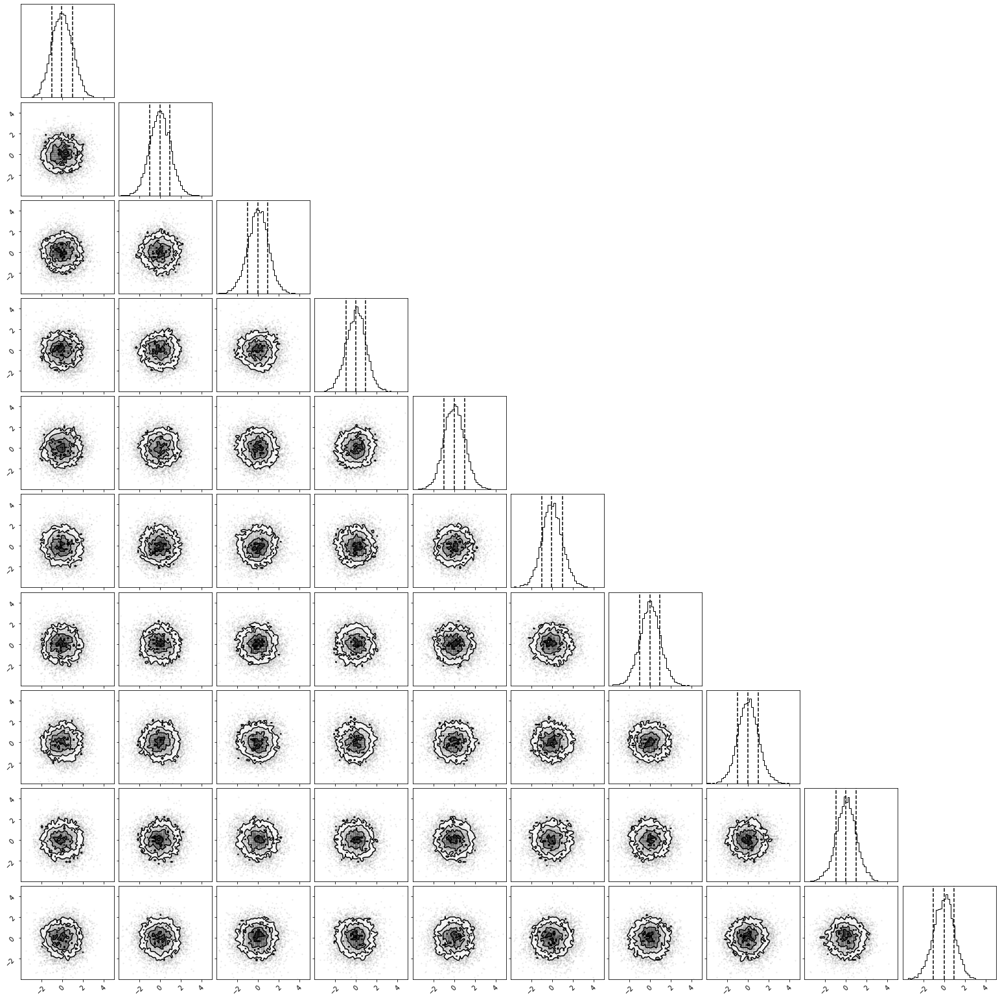

In [15]:
## do plot by class
corner.corner(test_gauss[0].cpu().numpy(),quantiles=[0.16, 0.5, 0.84], bins=50, range=[(-4,5) for ii in range(10)])
plt.show()

In [28]:
_, logj = model.forward(test_x, test_y, start=0, end=None)
logj=logj.cpu().numpy()

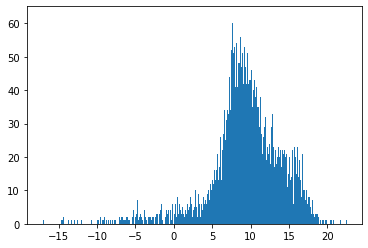

In [29]:
_ = plt.hist(logj,bins=1000)
plt.show()

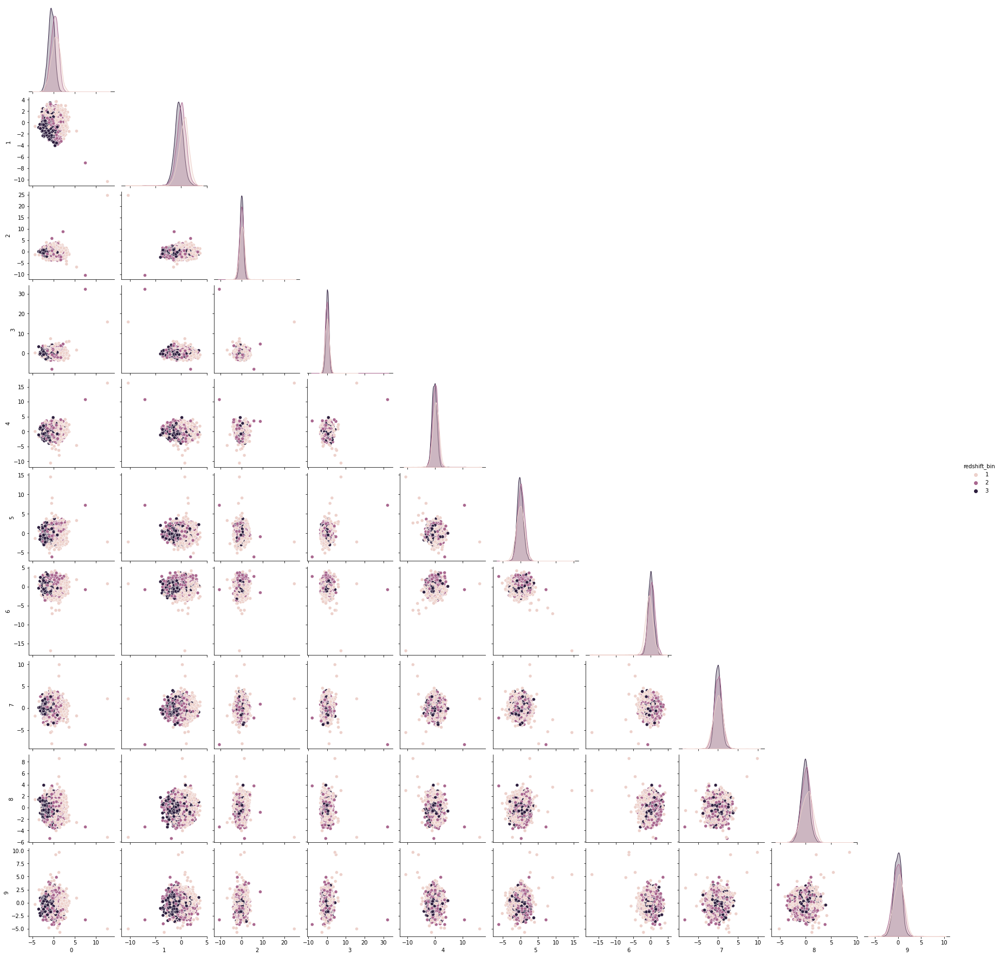

In [17]:
data=pd.DataFrame(test_gauss[0].cpu().numpy())
bins = np.digitize(test['z'],[0.4,0.3,0.2,0.1], right=False)
data['redshift_bin']=bins
sns.pairplot(data, corner=True, hue='redshift_bin')

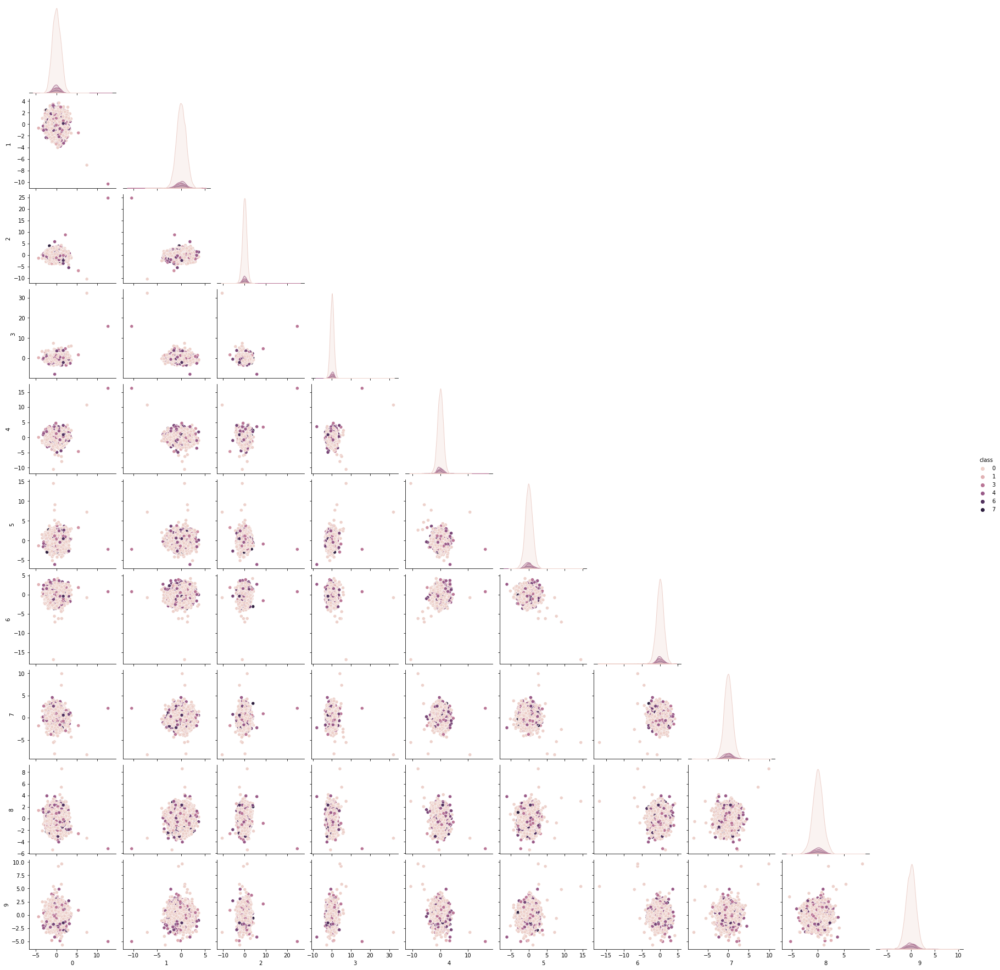

In [18]:
data=pd.DataFrame(test_gauss[0].cpu().numpy())
data['class']=test['subclass']
sns.pairplot(data, corner=True, hue='class')

In [14]:
dens      = model.evaluate_density(test_x,test_y).cpu().numpy()

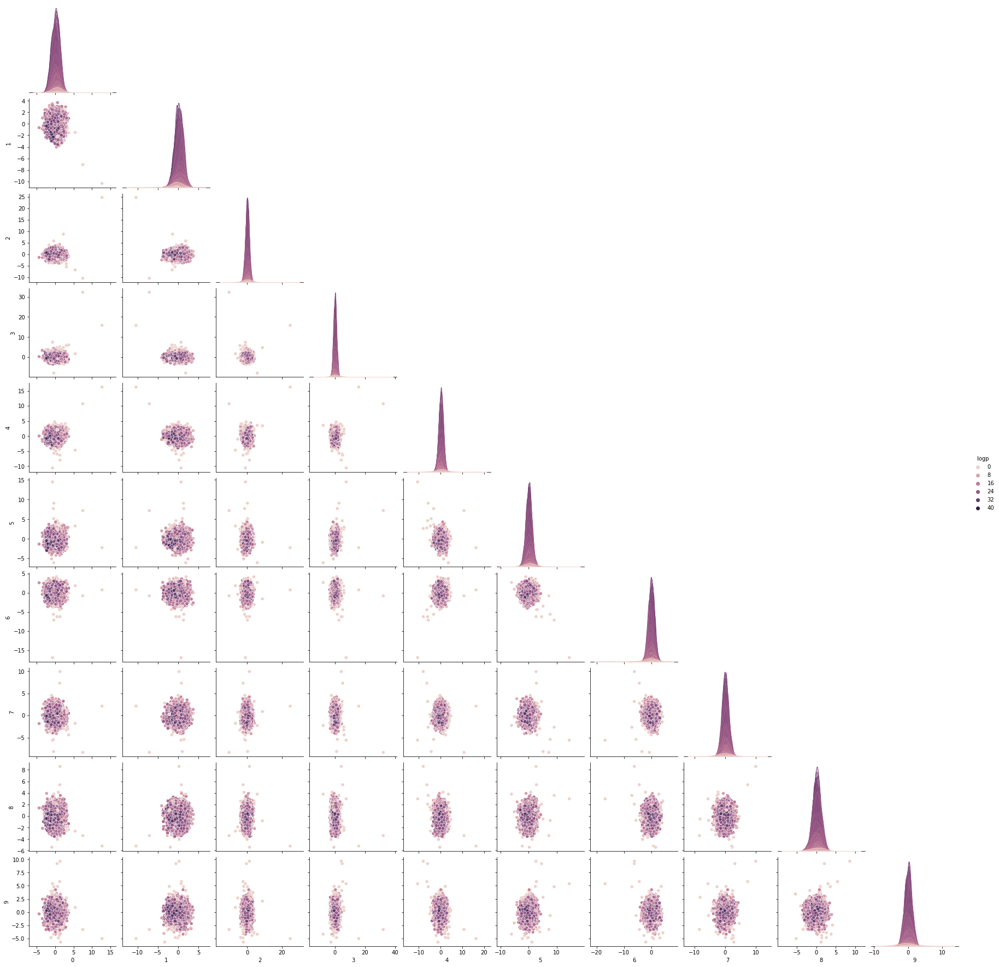

In [20]:
data = pd.DataFrame(test_gauss[0].cpu().numpy())
data['logp'] = np.digitize(dens,np.arange(-30,10), right=False)
sns.pairplot(data, corner=True, hue='logp')

In [86]:
df        = pd.DataFrame.from_dict(dict((k,test[k]) for k in ('MJD','fiber','plate','subclass') if k in test))
df['logp']= dens
df['mask_fracs'] = np.sum(~test['mask'].astype('bool'),axis=1)/1000
df['z'] = test['z']
noise = np.ma.array(np.squeeze(test['noise']),mask=~np.squeeze(test['mask'].astype('bool')))
df['recon_error'] = np.ma.mean(np.ma.array(np.squeeze(test['spec'])-decoded_test,mask=~np.squeeze(test['mask'].astype('bool')))**2*noise,axis=1)
df['max_recon_error'] = np.ma.max(np.ma.array(np.squeeze(test['spec'])-decoded_test,mask=~np.squeeze(test['mask'].astype('bool')))**2*noise,axis=1)
df        = df.reset_index()

In [87]:
import sklearn.linear_model
import sklearn.kernel_ridge
LRl1 = sklearn.linear_model.LinearRegression()
LR1 = sklearn.kernel_ridge.KernelRidge()

In [88]:
ind = (df['mask_fracs']>0.02)*(df['logp']>-50)
LR1.fit(df['mask_fracs'][ind,None],df['logp'][ind,None])
LRl1.fit(df['mask_fracs'][ind,None],df['logp'][ind,None])

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/pandas/core/computation/expressions.py:205: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  f"evaluating in Python space because the {repr(op_str)} "
/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  
/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  This is separate from the ipykernel package so we can avoid doing imports until


LinearRegression()

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:4: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  after removing the cwd from sys.path.
/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:5: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  """


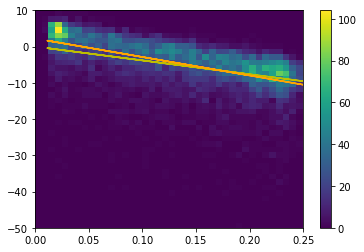

In [89]:
h =plt.hist2d(df['mask_fracs'], df['logp'], range=[[0,0.25],[-50,10]], bins=[40,40])
x= df['mask_fracs']
#plt.plot(x,LR.coef_[0]*x+LR.intercept_[0])
plt.plot(x, LR1.predict(x[:,None]),color='y')
plt.plot(x, LRl1.predict(x[:,None]),color='orange')
plt.colorbar(h[3])

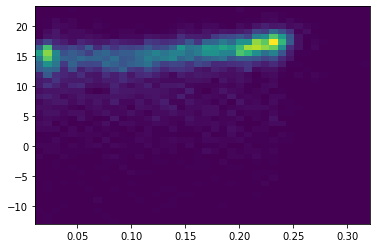

In [90]:
df['logj_corr']=logj-(LRl1.coef_[0]*x+LRl1.intercept_[0])
h =plt.hist2d(df['mask_fracs'], df['logj_corr'], bins=[40,40])

In [91]:
import scipy.stats
corr, _= scipy.stats.pearsonr(df['mask_fracs'][ind],df['logp'][ind])
print(corr)
df['logp_corr'] = df['logp']-(LRl1.coef_[0]*x+LRl1.intercept_[0])
corr, _= scipy.stats.pearsonr(df['mask_fracs'][ind],df['logp_corr'][ind])
print(corr)

-0.5352452153714001
-4.2500725161431774e-17


Text(0.5, 0, 'mask_fracs')

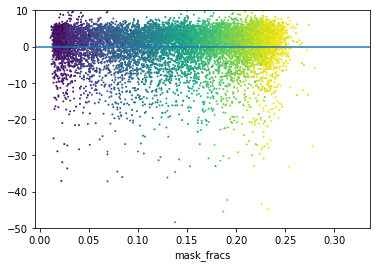

In [92]:
plt.scatter(df['mask_fracs'],df['logp_corr'], s=1, c=df['z'])
plt.axhline(0)
plt.ylim(-50,10)
plt.xlabel('mask_fracs')

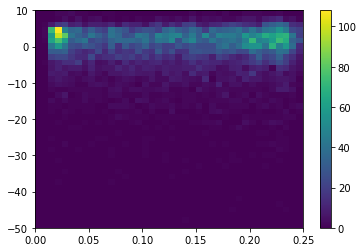

In [93]:
h =plt.hist2d(df['mask_fracs'], df['logp_corr'], range=[[0,0.25],[-50,10]], bins=[40,40])
plt.colorbar()

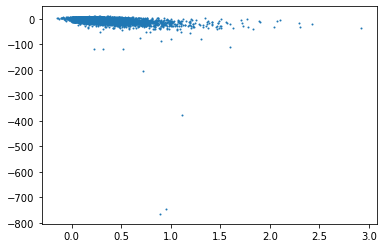

In [94]:
plt.scatter(np.log(df['recon_error']),df['logp'],s=1)

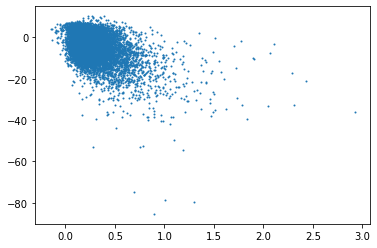

In [95]:
plt.scatter(np.log(df['recon_error'][df['logp']>-100]),df['logp'][df['logp']>-100],s=1)

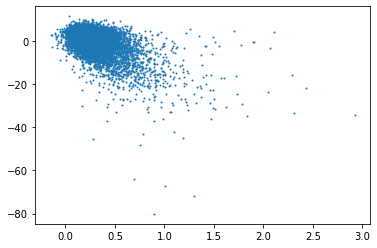

In [96]:
plt.scatter(np.log(df['recon_error'][df['logp_corr']>-100]),df['logp_corr'][df['logp_corr']>-100],s=1)

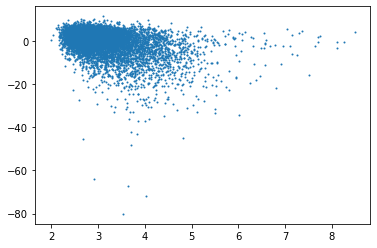

In [97]:
plt.scatter(np.log(df['max_recon_error'][df['logp_corr']>-100]),df['logp_corr'][df['logp_corr']>-100],s=1)

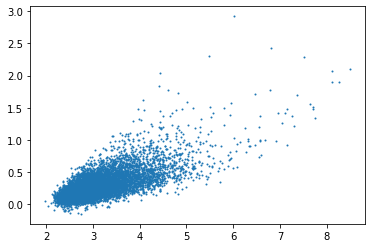

In [98]:
plt.scatter(np.log(df['max_recon_error'][df['logp_corr']>-100]),np.log(df['recon_error'][df['logp_corr']>-100]),s=1)

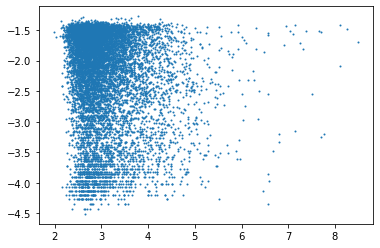

In [99]:
plt.scatter(np.log(df['max_recon_error'][df['logp_corr']>-100]),np.log(df['mask_fracs'][df['logp_corr']>-100]),s=1)

In [100]:
LRl2 = sklearn.linear_model.LinearRegression()

LRl2.fit((df['mask_fracs'])[:,None],np.log(df['max_recon_error'])[:,None])

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  This is separate from the ipykernel package so we can avoid doing imports until


LinearRegression()

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  


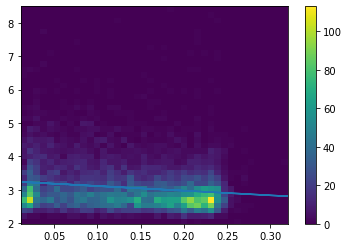

In [101]:
h =plt.hist2d(df['mask_fracs'], np.log(df['max_recon_error']), bins=[40,40])
plt.plot(df['mask_fracs'],LRl2.predict((df['mask_fracs'])[:,None])[:,0])
plt.colorbar()

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  """Entry point for launching an IPython kernel.


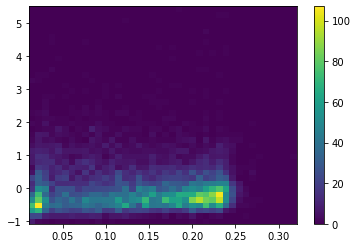

In [102]:
h = plt.hist2d(df['mask_fracs'], np.log(df['max_recon_error'])-LRl2.predict((df['mask_fracs'])[:,None])[:,0], bins=[40,40])
plt.colorbar()

In [108]:
df['log_max_error_corr'] = np.log(df['max_recon_error'])#-LRl2.predict((df['mask_fracs'])[:,None])[:,0]

In [109]:
LRl3 = sklearn.linear_model.LinearRegression()

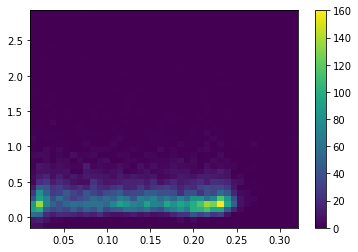

In [110]:
h =plt.hist2d(df['mask_fracs'], np.log(df['recon_error']), bins=[40,40])
plt.colorbar()

In [111]:
LRl3.fit((df['mask_fracs'])[:,None],np.log(df['recon_error'])[:,None])

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  """Entry point for launching an IPython kernel.


LinearRegression()

/global/homes/v/vboehm/.conda/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  


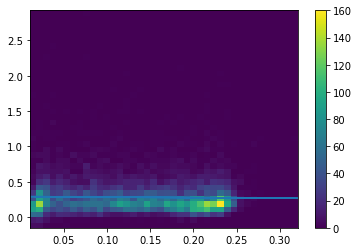

In [112]:
h =plt.hist2d(df['mask_fracs'], np.log(df['recon_error']), bins=[40,40])
plt.plot(df['mask_fracs'],LRl3.predict((df['mask_fracs'])[:,None])[:,0])
plt.colorbar()

In [113]:
df['log_error_corr'] = np.log(df['recon_error'])#-LRl3.predict((df['mask_fracs'])[:,None])[:,0]

In [114]:
df['logpG'] = df['logp_corr']-df['logj_corr']

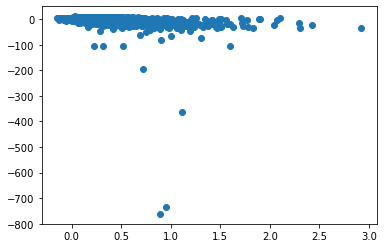

In [115]:
plt.scatter(df['log_error_corr'],df['logp_corr'])

In [116]:
scipy.stats.pearsonr(df['log_error_corr'],df['logp_corr'])

(-0.3029483315060926, 3.177496030792366e-212)

Text(0, 0.5, 'logp Gauss')

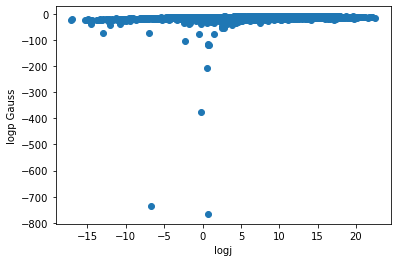

In [117]:
plt.scatter(logj,df['logp_corr']-df['logj_corr'])
plt.xlabel('logj')
plt.ylabel('logp Gauss')

Text(0, 0.5, 'logp')

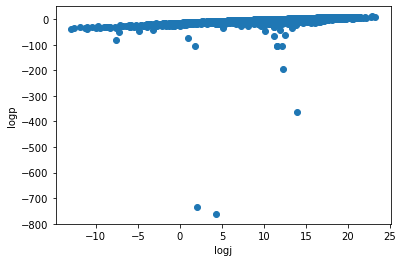

In [103]:
plt.scatter(df['logj_corr'],df['logp_corr'])
plt.xlabel('logj')
plt.ylabel('logp')

Text(0, 0.5, 'logpG/logj')

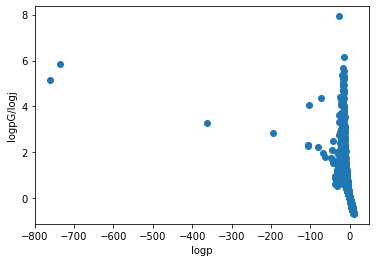

In [109]:
plt.scatter(df['logp_corr'],np.log(abs(df['logpG'])/abs(df['logj_corr'])))
plt.xlabel('logp')
plt.ylabel('logpG/logj')

Text(0, 0.5, 'log10(|logpG|/|logj|)')

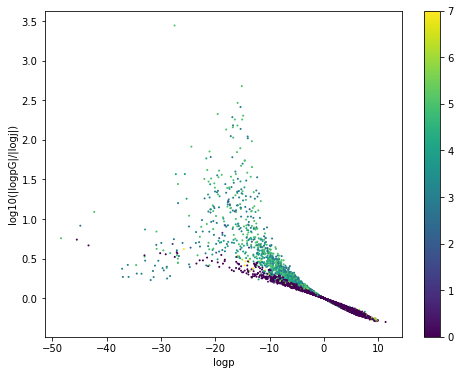

In [116]:
plt.figure(figsize=(8,6))
plt.scatter(df['logp_corr'][df['logp_corr']>-50],np.log10(abs(df['logpG'][df['logp_corr']>-50])/abs(df['logj_corr'])[df['logp_corr']>-50]),c=df['subclass'][df['logp_corr']>-50], s=1)
plt.colorbar()
plt.xlabel('logp')
plt.ylabel('log10(|logpG|/|logj|)')

Text(0, 0.5, 'logp')

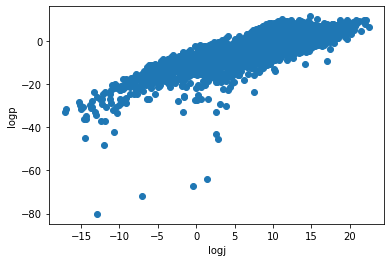

In [71]:
plt.scatter(logj[df['logp_corr']>-100],df['logp_corr'][df['logp_corr']>-100])
plt.xlabel('logj')
plt.ylabel('logp')

In [73]:
scipy.stats.pearsonr(logj,df['logp_corr']-logj)

(0.009640342384366823, 0.3340166677870277)

In [118]:
scipy.stats.pearsonr(df['log_error_corr'],df['logp_corr'])

(-0.3029483315060926, 3.177496030792366e-212)

In [119]:
scipy.stats.pearsonr(df['log_error_corr'],df['log_max_error_corr'])

(0.7151243711530094, 0.0)

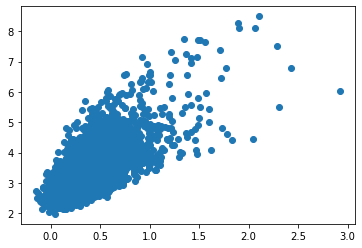

In [120]:
plt.scatter(df['log_error_corr'],df['log_max_error_corr'])

In [44]:
df.columns

Index(['index', 'MJD', 'fiber', 'plate', 'subclass', 'logp', 'mask_fracs', 'z',
       'recon_error', 'max_recon_error', 'logp_corr', 'log_max_error_corr',
       'log_error_corr'],
      dtype='object')

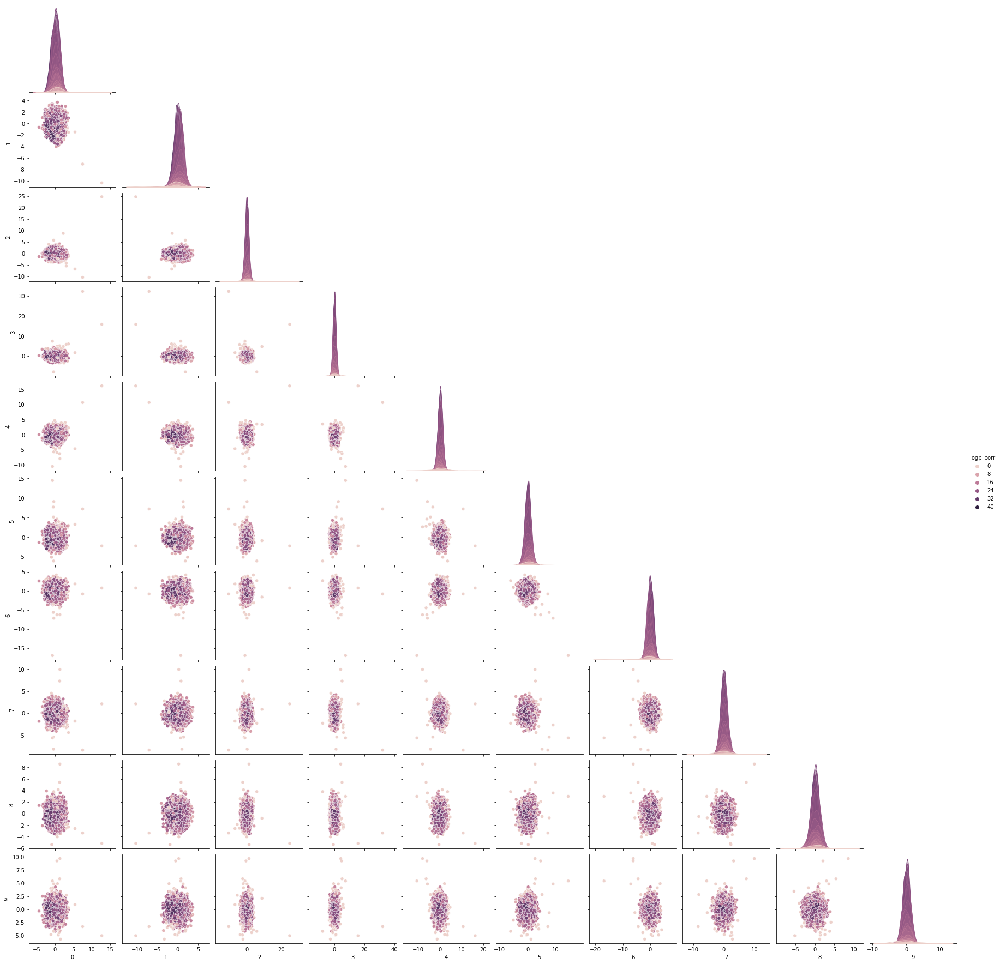

In [45]:
data=pd.DataFrame(test_gauss[0].cpu().numpy())
data['logp_corr']= np.digitize(dens,np.arange(-30,10), right=False)
sns.pairplot(data, corner=True, hue='logp_corr')

### Mask fraction corrected logp

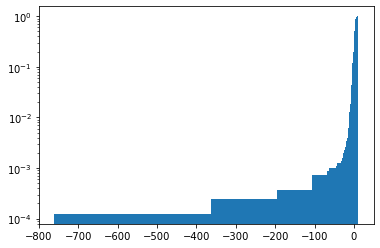

Anomalous Spectra


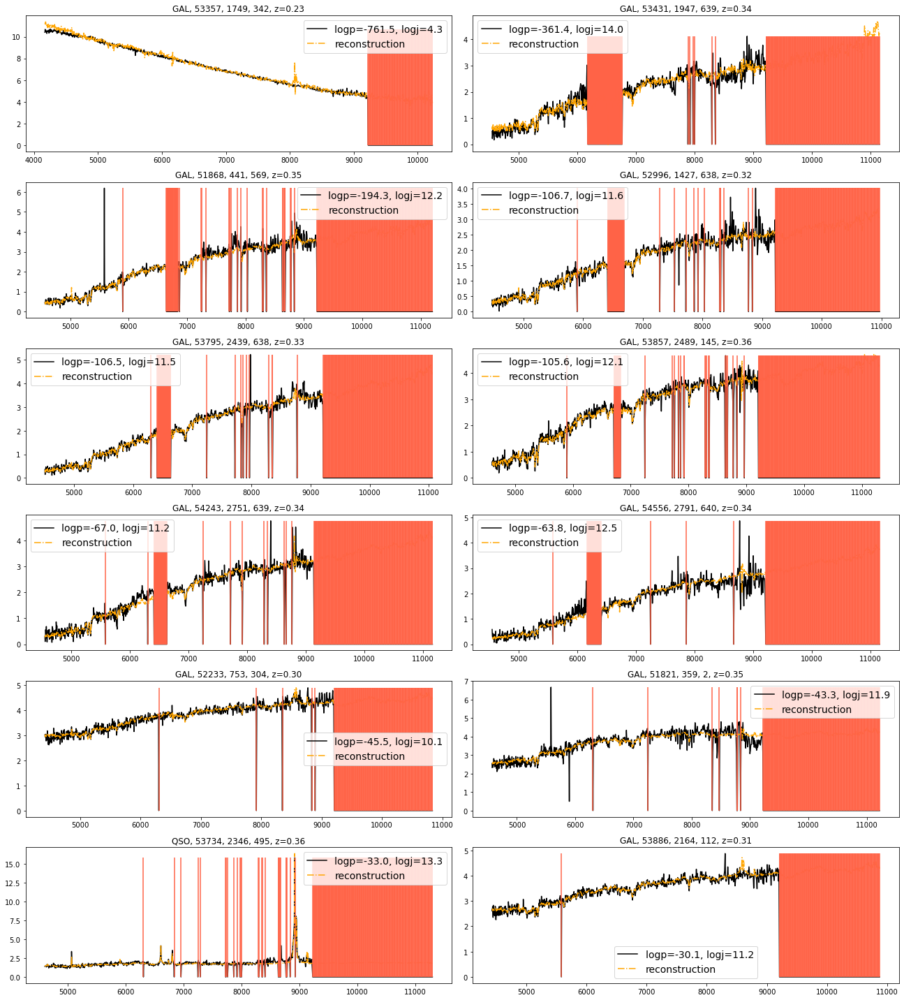

Most Normal Spectra


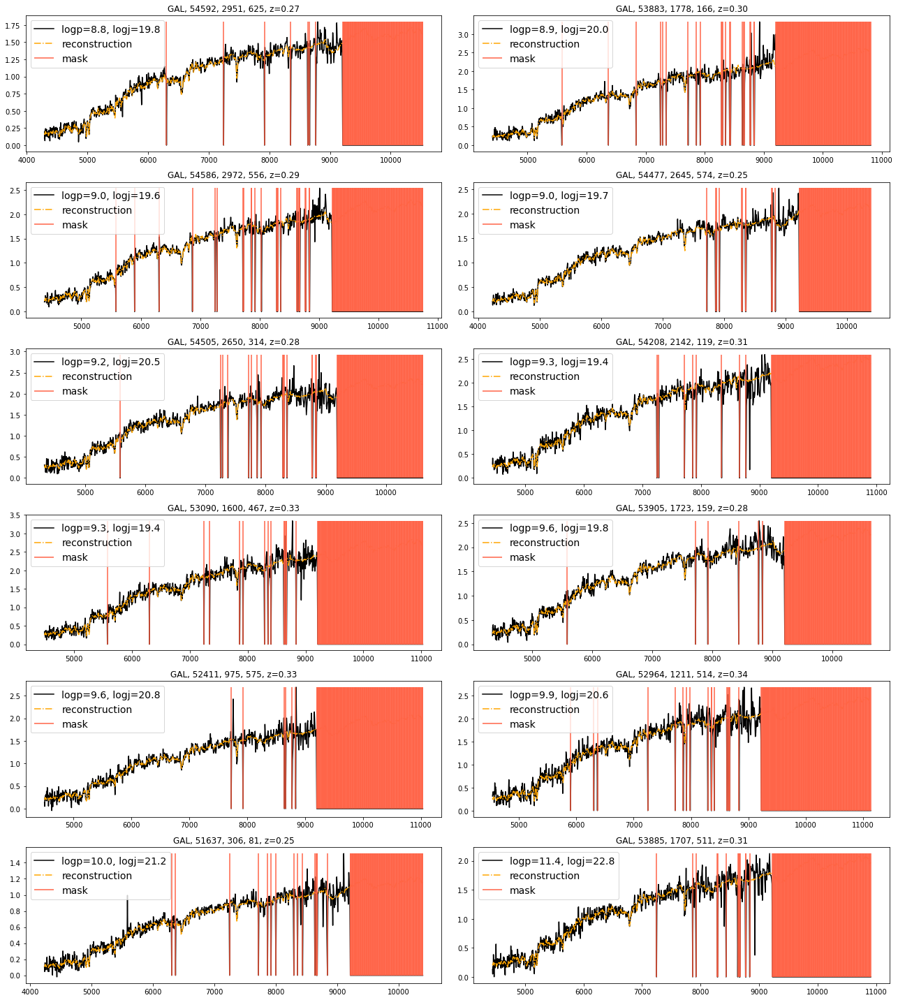

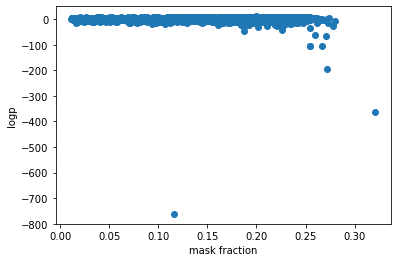

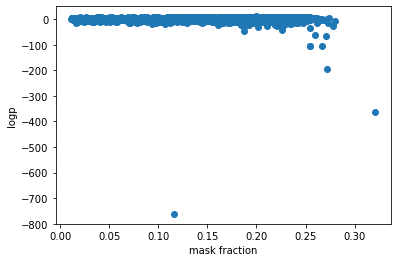

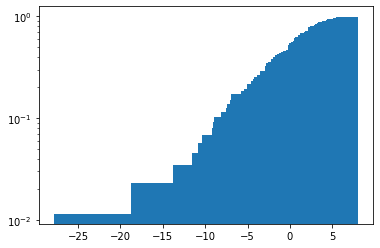

Anomalous Spectra


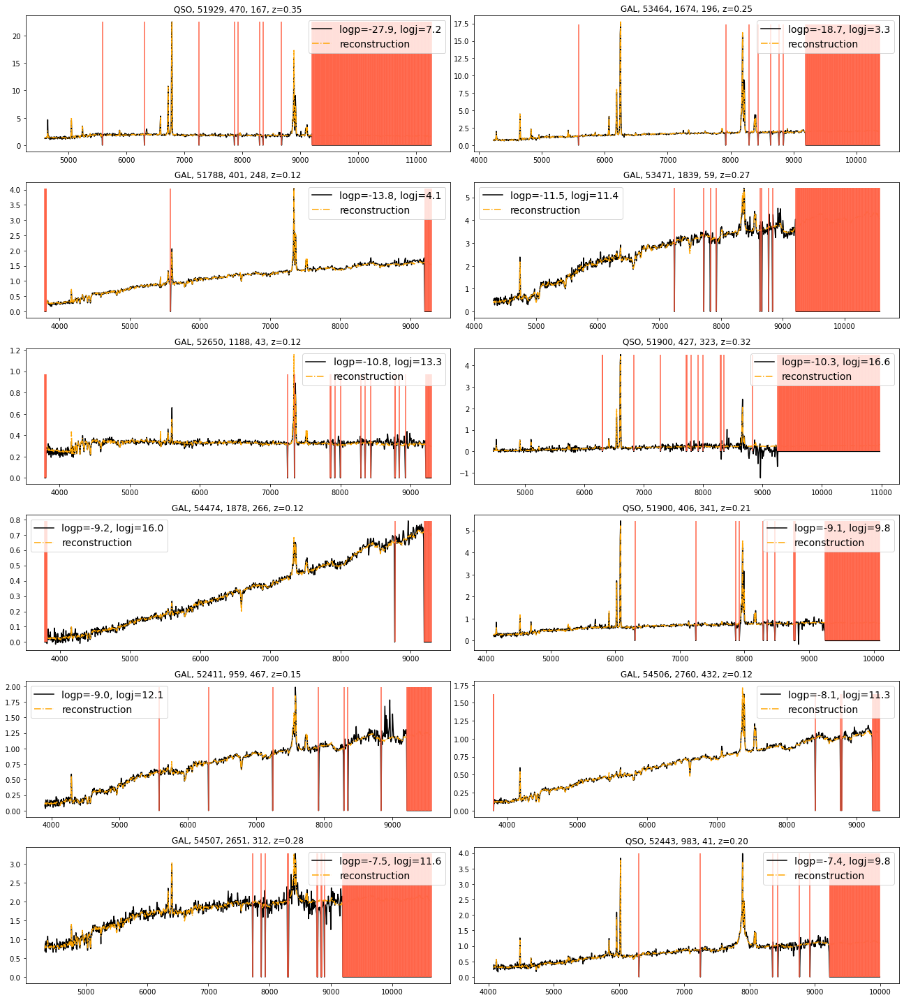

Most Normal Spectra


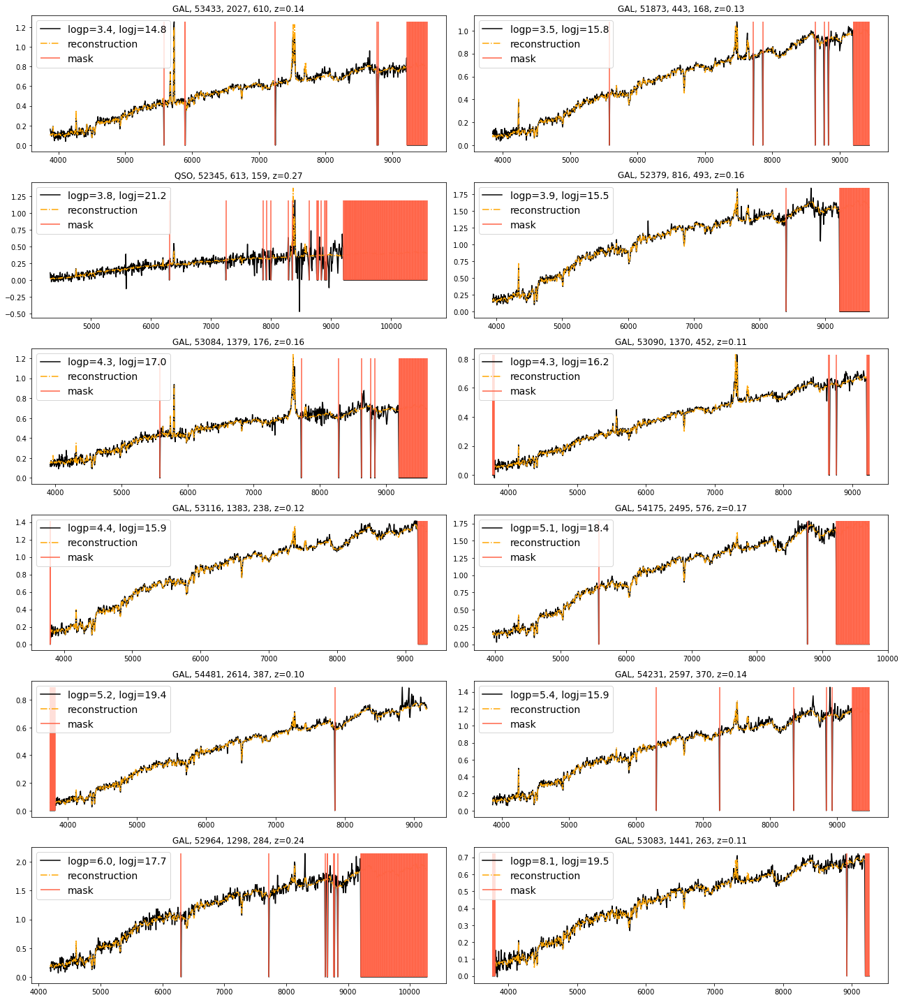

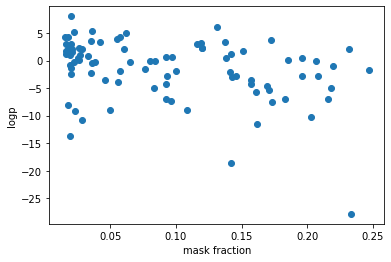

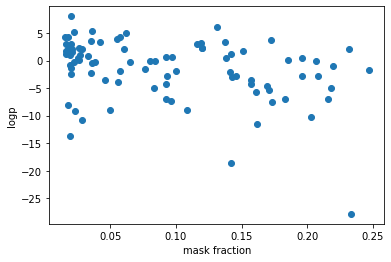

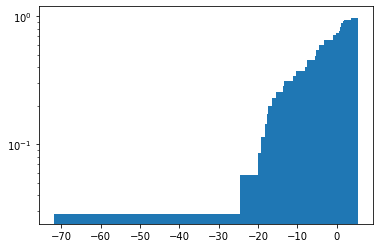

Anomalous Spectra


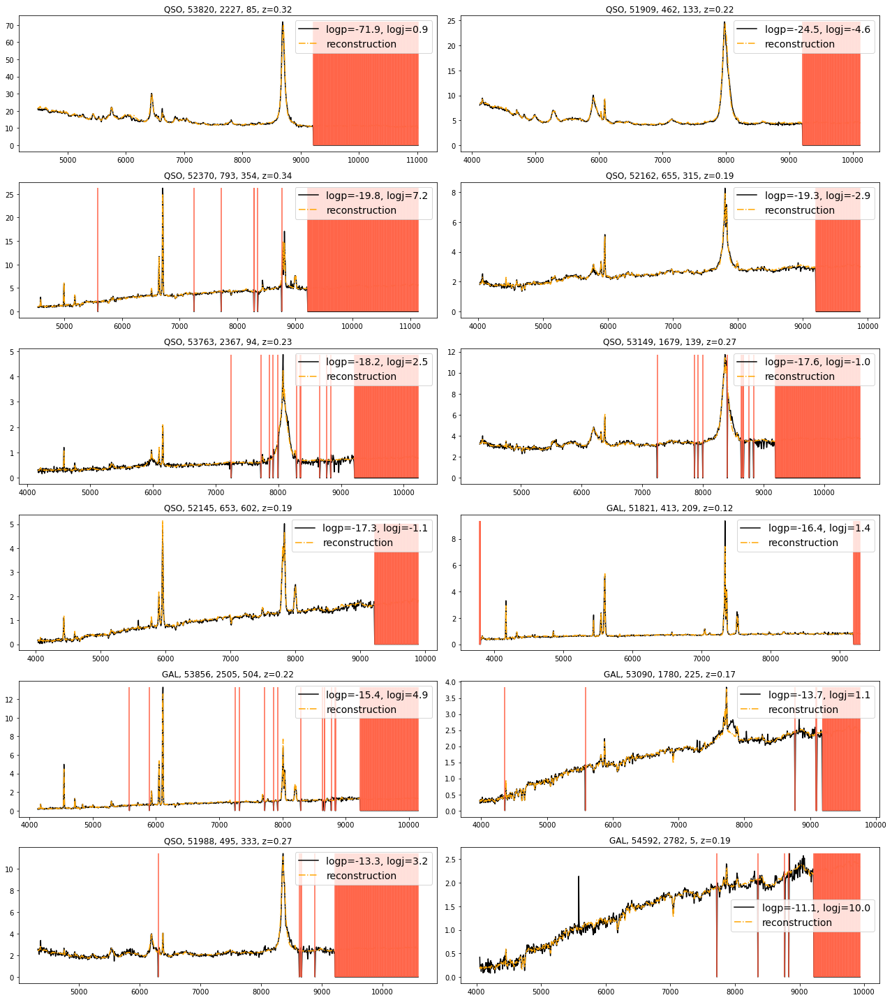

Most Normal Spectra


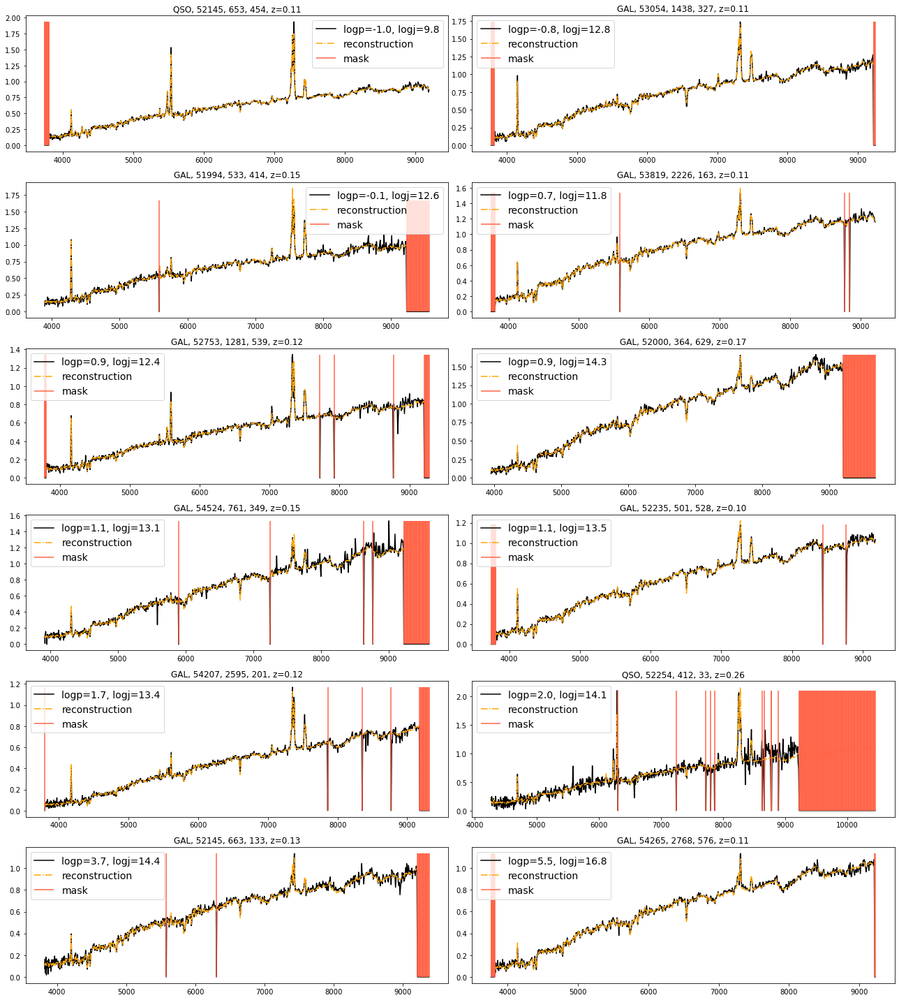

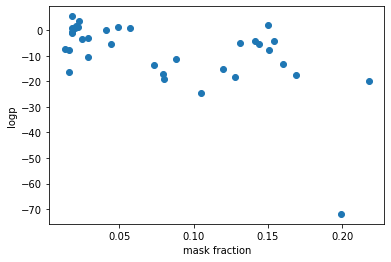

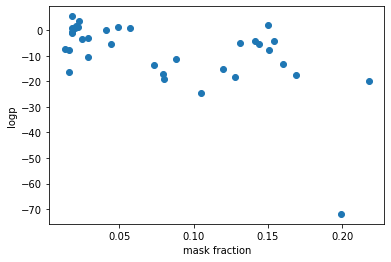

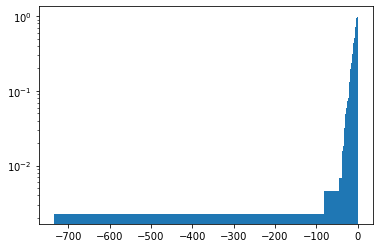

Anomalous Spectra


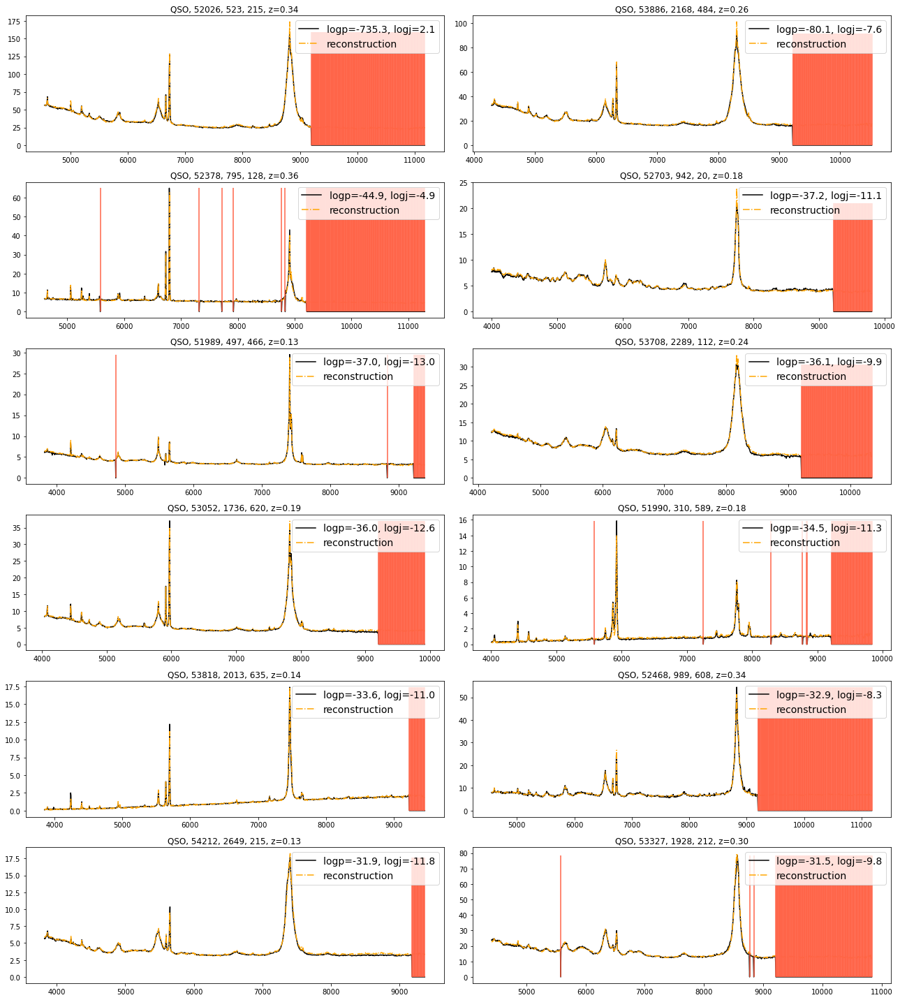

Most Normal Spectra


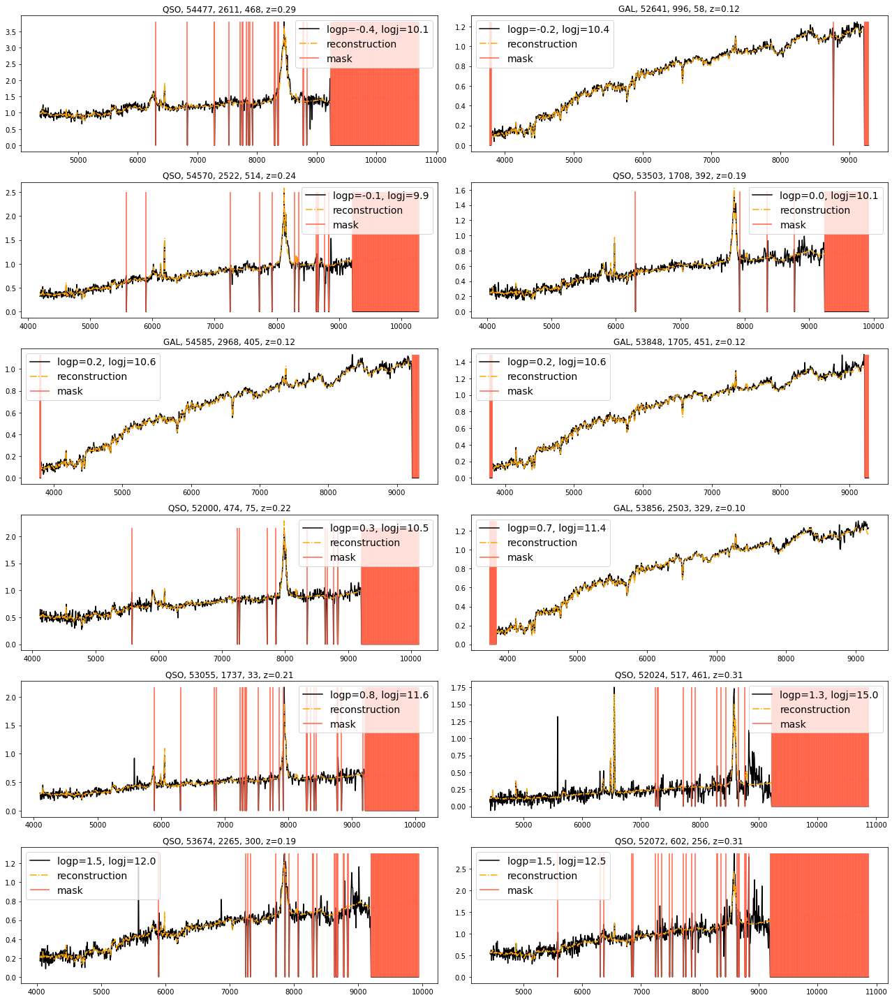

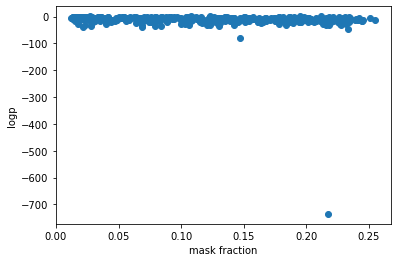

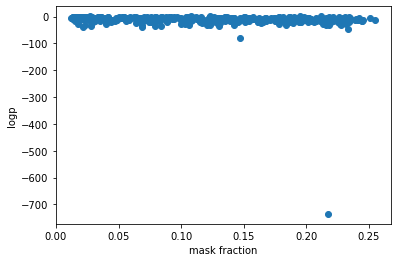

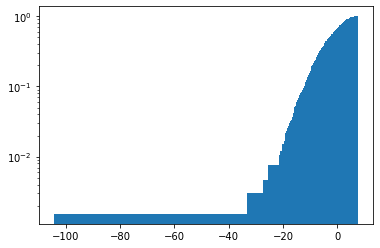

Anomalous Spectra


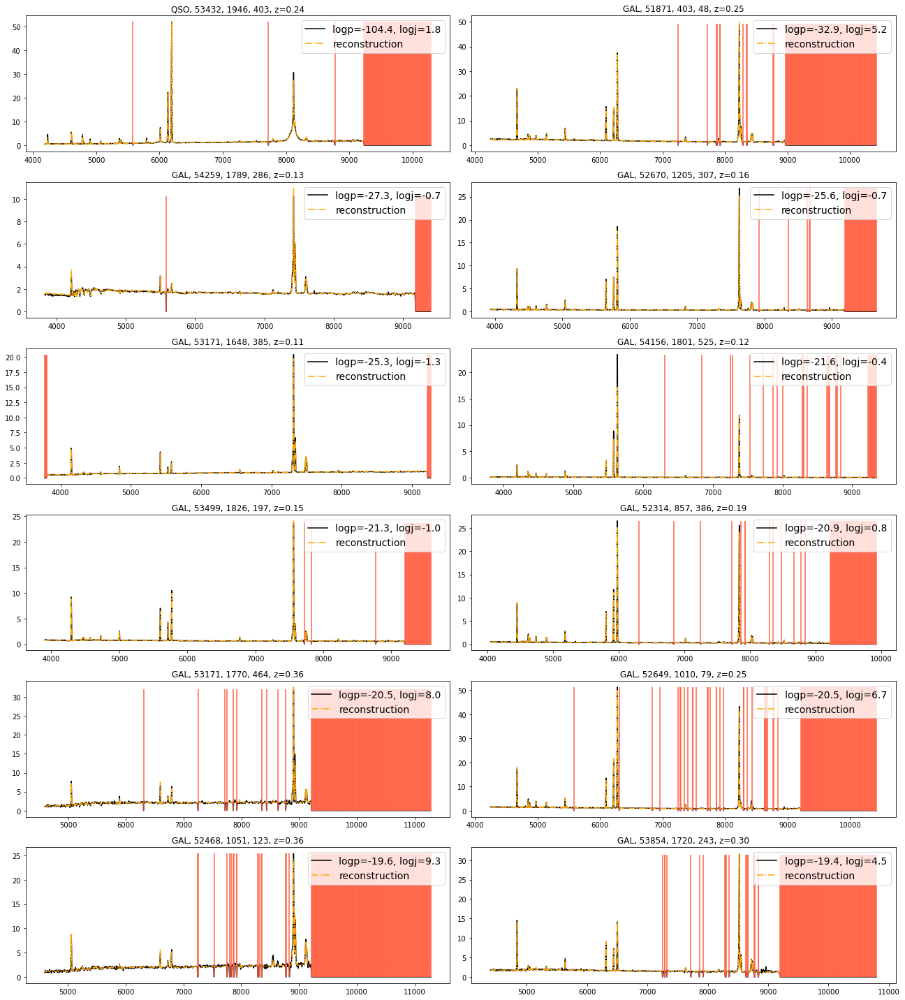

Most Normal Spectra


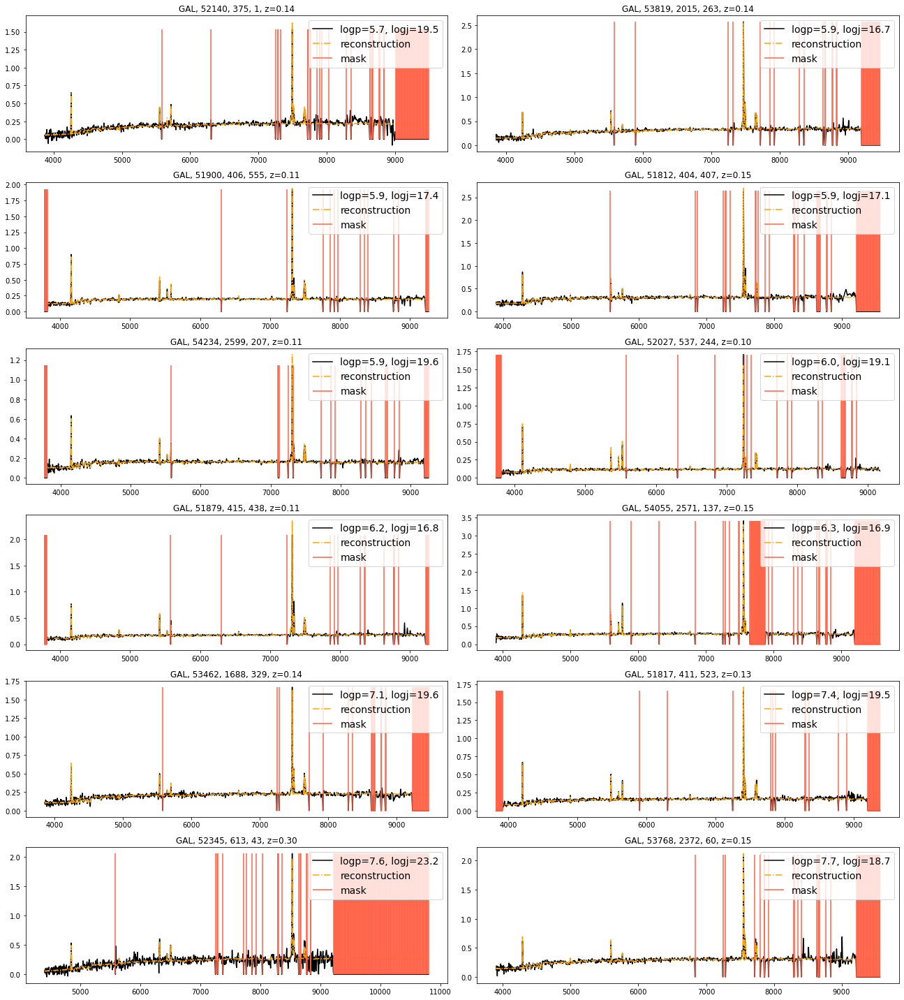

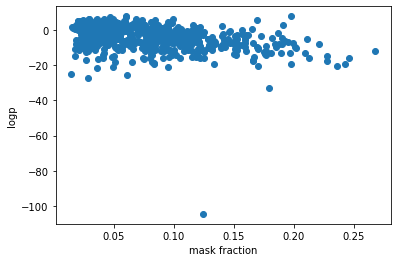

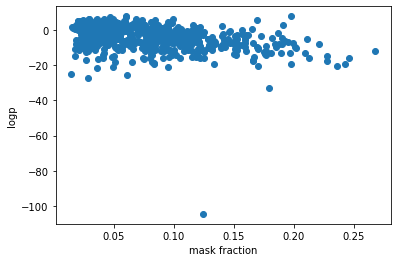

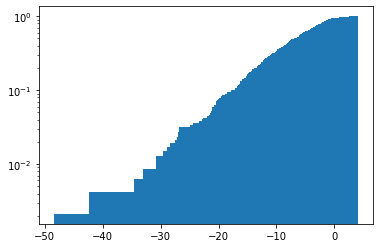

Anomalous Spectra


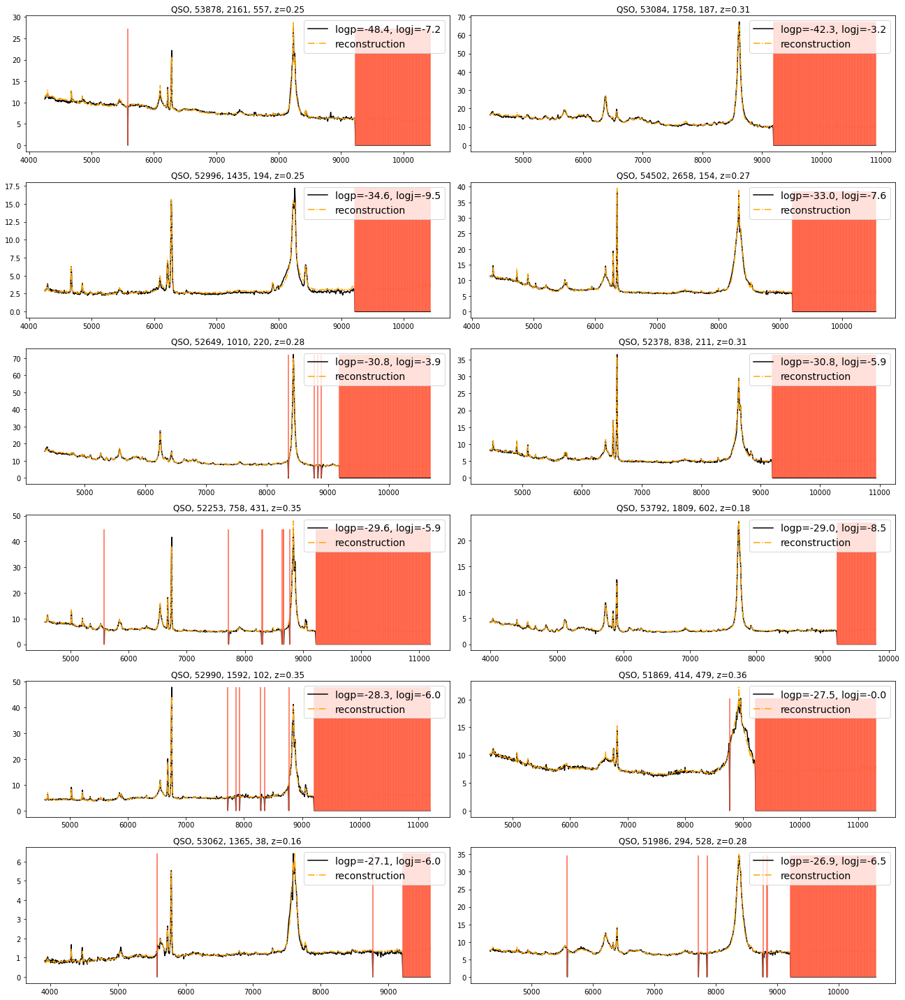

Most Normal Spectra


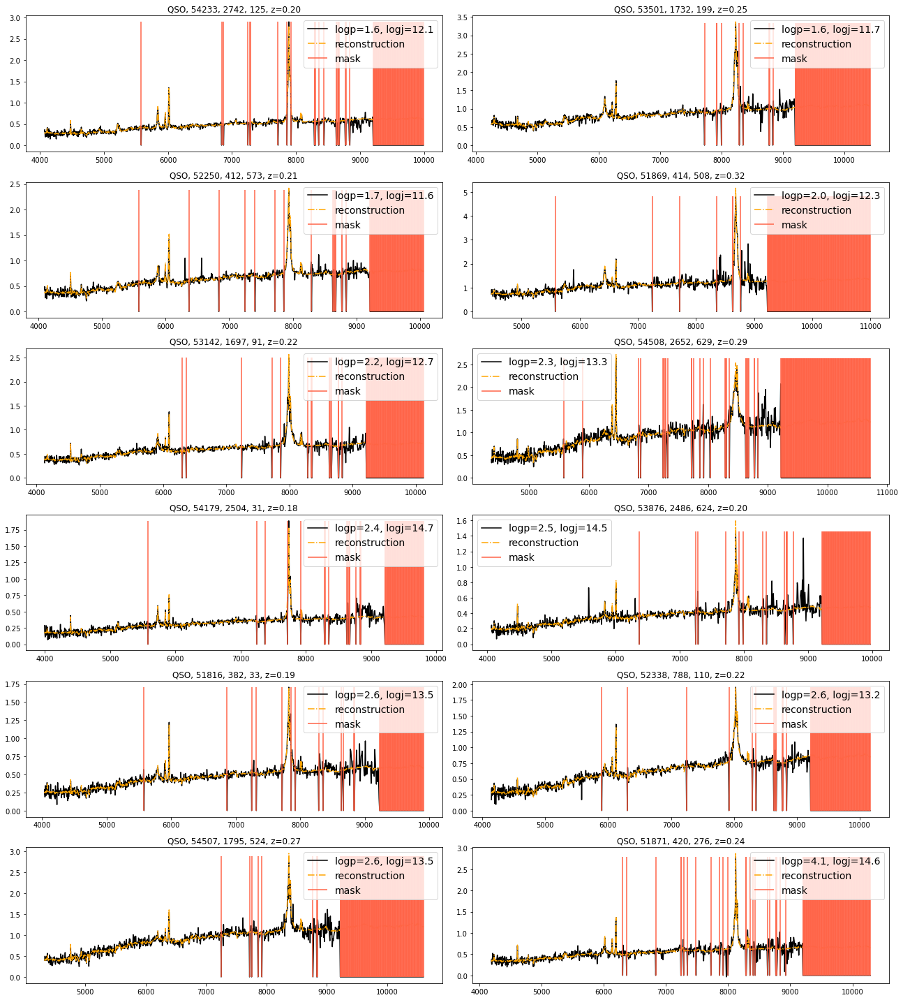

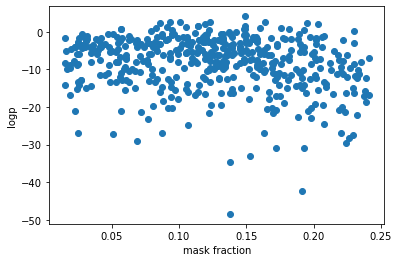

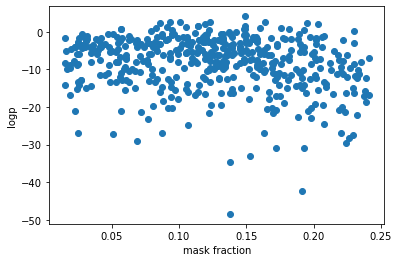

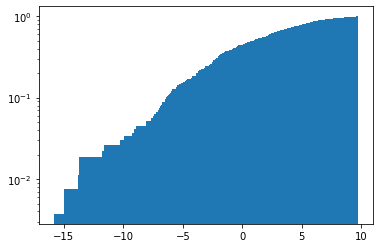

Anomalous Spectra


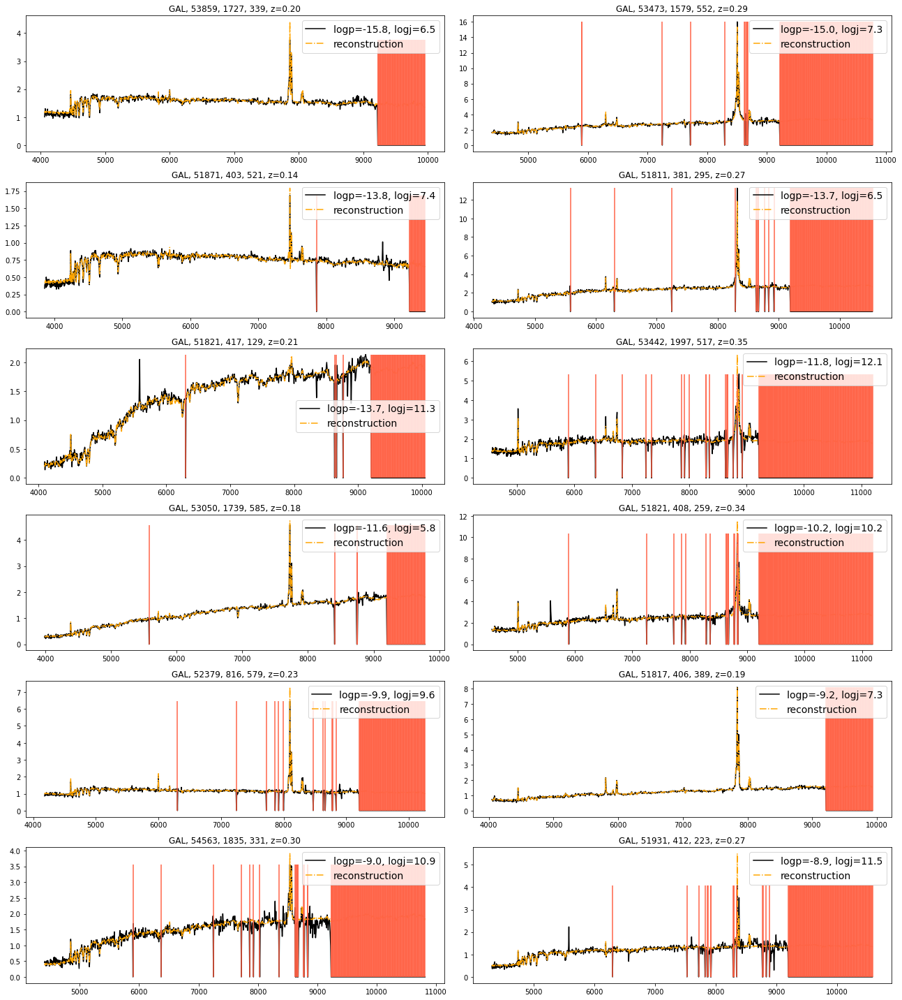

Most Normal Spectra


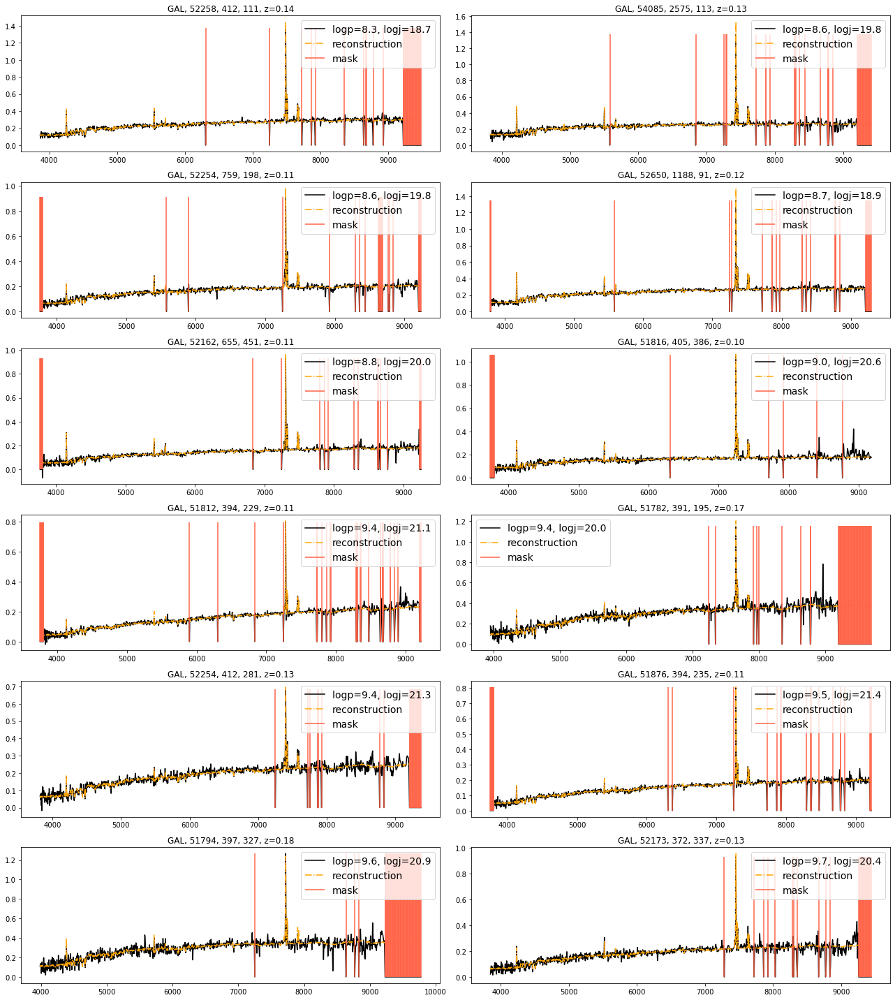

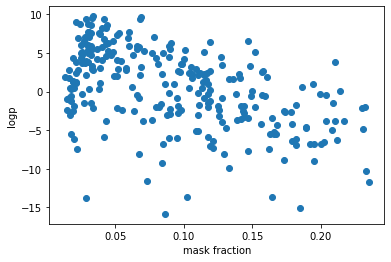

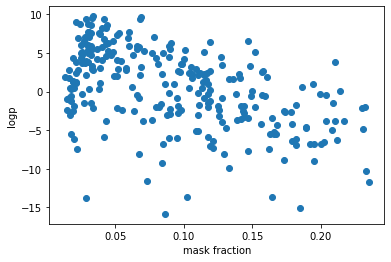

In [115]:

for mm in range(7):
    ind = np.where(test['subclass']==mm)[0]

    mask_fracs      = np.sum(~test['mask'].astype('bool'),axis=1)/1000

    dens            = df['logp_corr'].iloc[ind].to_numpy()
    logj            = df['logj_corr'].iloc[ind].to_numpy()

    ind_ood         = np.argsort(dens)
    dens_sorted     = dens[ind_ood]
    logj_sorted      = logj[ind_ood]
    test_x_sorted   = test_x[ind][ind_ood].cpu().numpy()


    cum, bins, _      = plt.hist(dens_sorted,bins=500,density=True, cumulative=True, log=True)
    plt.show()

    outliers_decoded  = decoded_test[ind][ind_ood]
    outliers_input    = test['spec'][ind][ind_ood]

    wlmin, wlmax      = (3388,8318)
    fixed_num_bins    = 1000
    wl_range          = (np.log10(wlmin),np.log10(wlmax))
    # new binning 
    new_wl            = np.logspace(wl_range[0],wl_range[1],fixed_num_bins+1)


    print('Anomalous Spectra')
    fi, ax = plt.subplots(6,2,figsize=(18,20))
    ax = ax.flatten()
    for ii in range(12):
        ax[ii].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
        ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='logp=%.1f, logj=%.1f'%(dens_sorted[ii],logj_sorted[ii]), color='black')
        ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
        ax[ii].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4)

        ax[ii].legend(fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(plotpath,'logp_outliers_class_%s'%(le.inverse_transform([mm])[0]).decode('utf8')), bbox_inches='tight')
    plt.show()

    print('Most Normal Spectra')
    fi, ax = plt.subplots(6,2,figsize=(18,20))
    ax = ax.flatten()
    for nn, ii in enumerate(range(len(ind_ood)-12,len(ind_ood))):
        ax[nn].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
        ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='logp=%.1f, logj=%.1f'%(dens_sorted[ii],logj_sorted[ii]), color='black')
        ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
        ax[nn].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4, label='mask')

        ax[nn].legend(fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(plotpath,'logp_most_common_class_%s'%(le.inverse_transform([mm])[0]).decode('utf8')), bbox_inches='tight')
    plt.show()

    mask_fracs = np.sum(~test['mask'].astype('bool'),axis=1)/1000

    plt.xlabel('mask fraction')
    plt.ylabel('logp')
    plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
    plt.show()



    plt.xlabel('mask fraction')
    plt.ylabel('logp')
    plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
    plt.show()

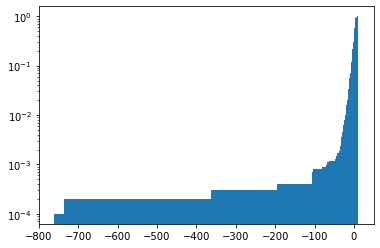

Anomalous Spectra


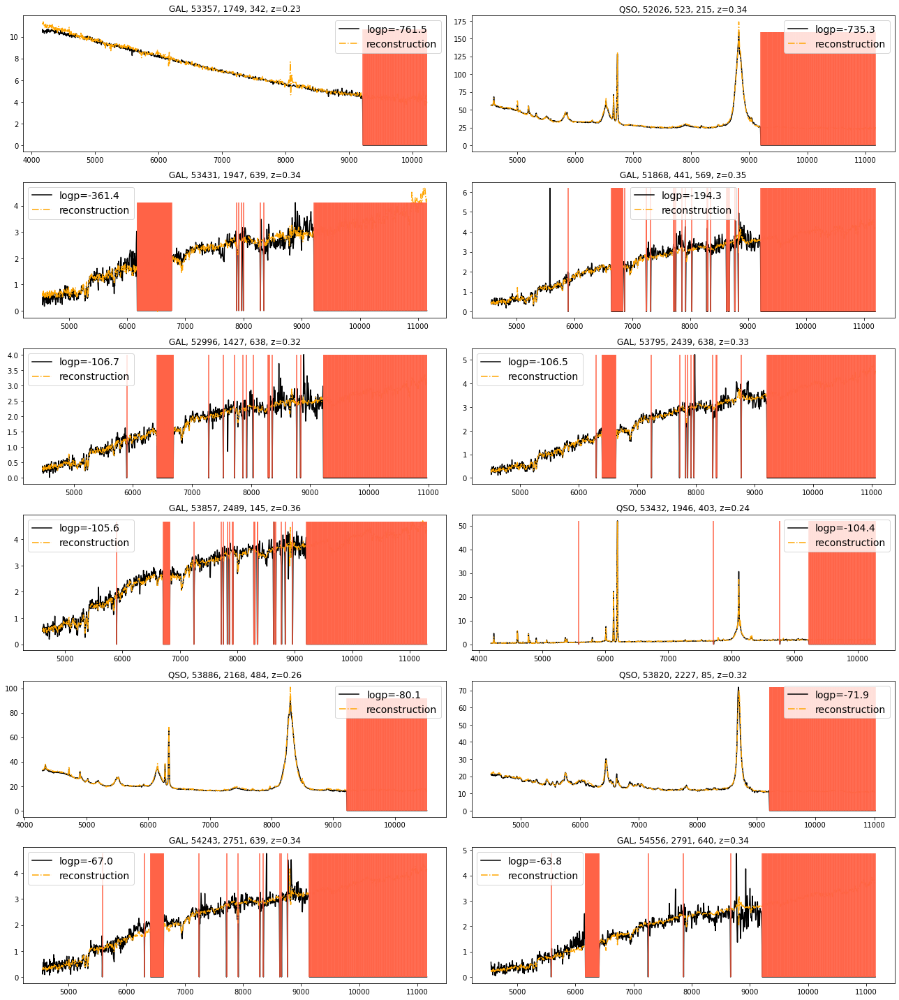

Most Normal Spectra


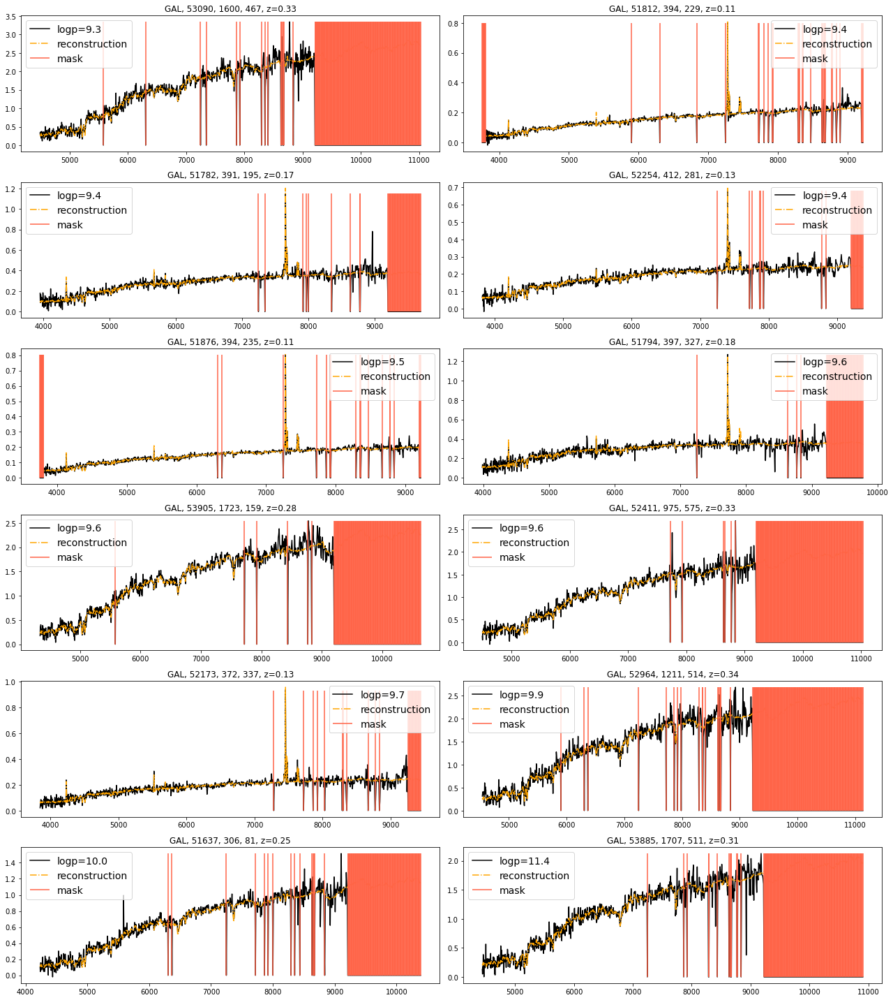

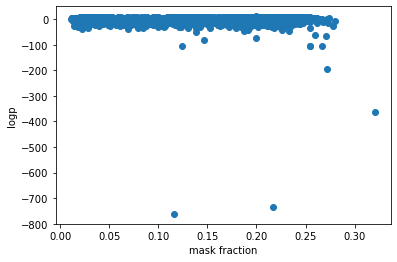

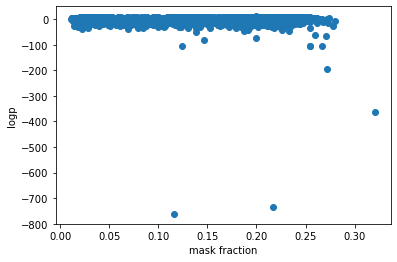

In [40]:

ind = np.arange(len(df))

mask_fracs      = np.sum(~test['mask'].astype('bool'),axis=1)/1000

dens            = df['logp_corr'].iloc[ind].to_numpy()

ind_ood         = np.argsort(dens)
dens_sorted     = dens[ind_ood]
test_x_sorted   = test_x[ind][ind_ood].cpu().numpy()


cum, bins, _      = plt.hist(dens_sorted,bins=500,density=True, cumulative=True, log=True)
plt.show()

outliers_decoded  = decoded_test[ind][ind_ood]
outliers_input    = test['spec'][ind][ind_ood]

wlmin, wlmax      = (3388,8318)
fixed_num_bins    = 1000
wl_range          = (np.log10(wlmin),np.log10(wlmax))
# new binning 
new_wl            = np.logspace(wl_range[0],wl_range[1],fixed_num_bins+1)


print('Anomalous Spectra')
fi, ax = plt.subplots(6,2,figsize=(18,20))
ax = ax.flatten()
for ii in range(12):
    ax[ii].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
    ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='logp=%.1f'%dens_sorted[ii], color='black')
    ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
    ax[ii].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4)

    ax[ii].legend(fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(plotpath,'logp_outliers_class_all_classes'), bbox_inches='tight')
plt.show()

print('Most Normal Spectra')
fi, ax = plt.subplots(6,2,figsize=(18,20))
ax = ax.flatten()
for nn, ii in enumerate(range(len(ind_ood)-12,len(ind_ood))):
    ax[nn].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
    ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='logp=%.1f'%dens_sorted[ii], color='black')
    ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
    ax[nn].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4, label='mask')

    ax[nn].legend(fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(plotpath,'logp_most_common_class_all_classes'), bbox_inches='tight')
plt.show()

mask_fracs = np.sum(~test['mask'].astype('bool'),axis=1)/1000

plt.xlabel('mask fraction')
plt.ylabel('logp')
plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
plt.show()



plt.xlabel('mask fraction')
plt.ylabel('logp')
plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
plt.show()

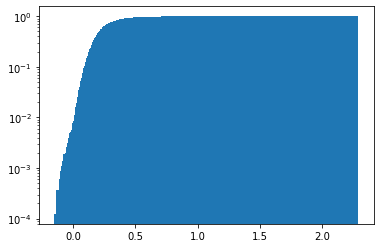

Anomalous Spectra


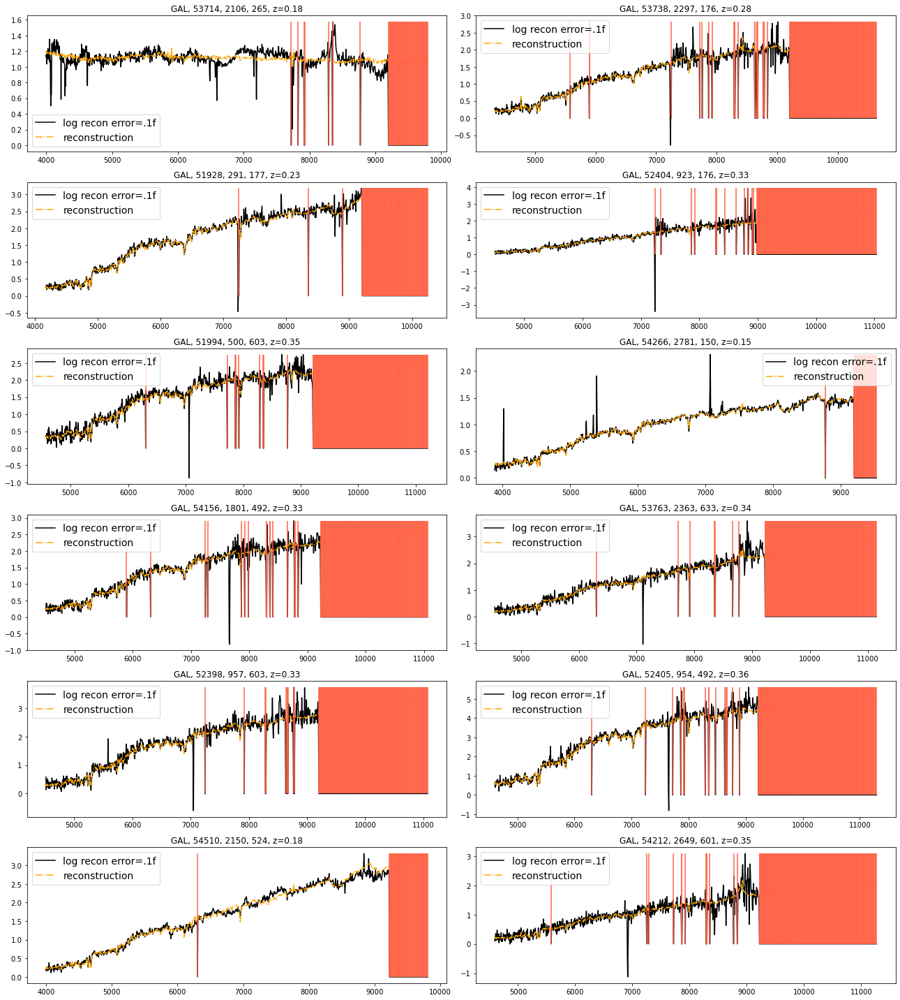

Most Normal Spectra


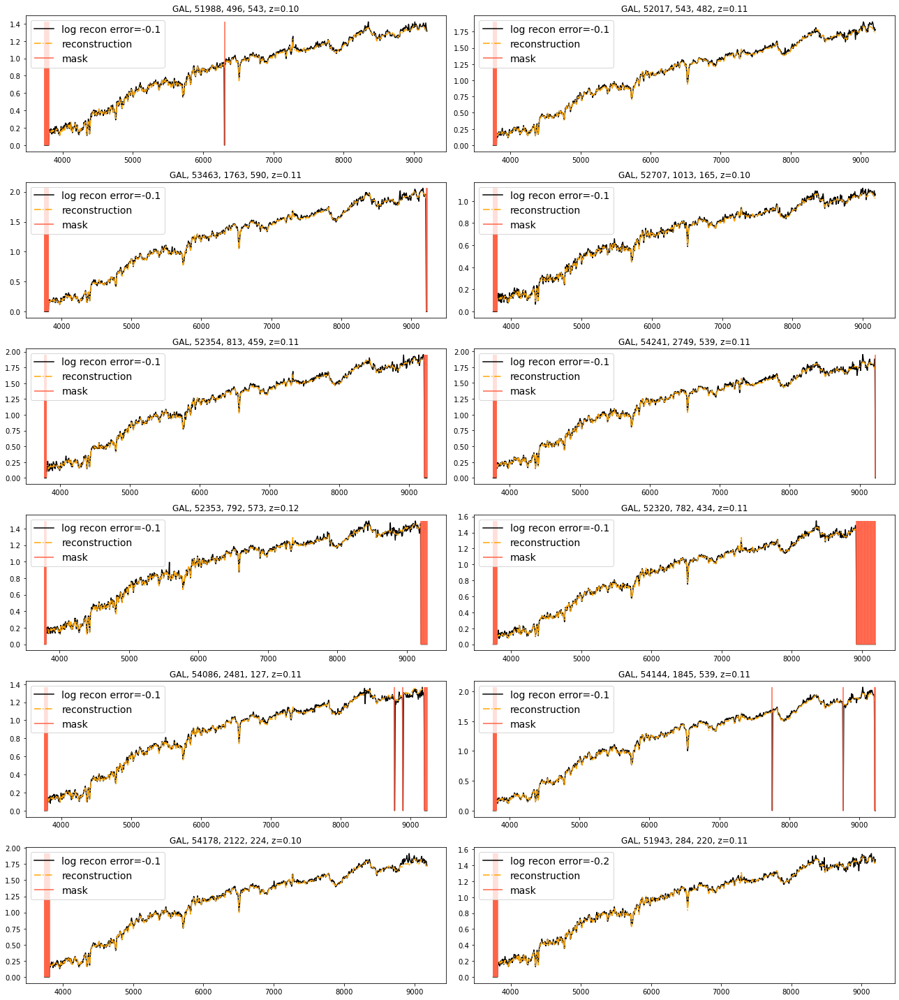

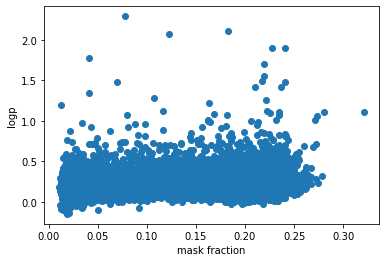

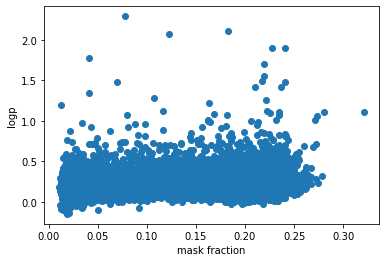

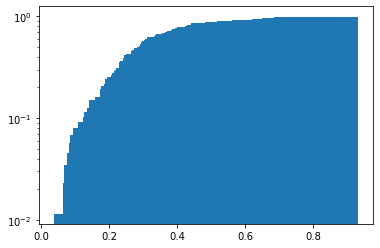

Anomalous Spectra


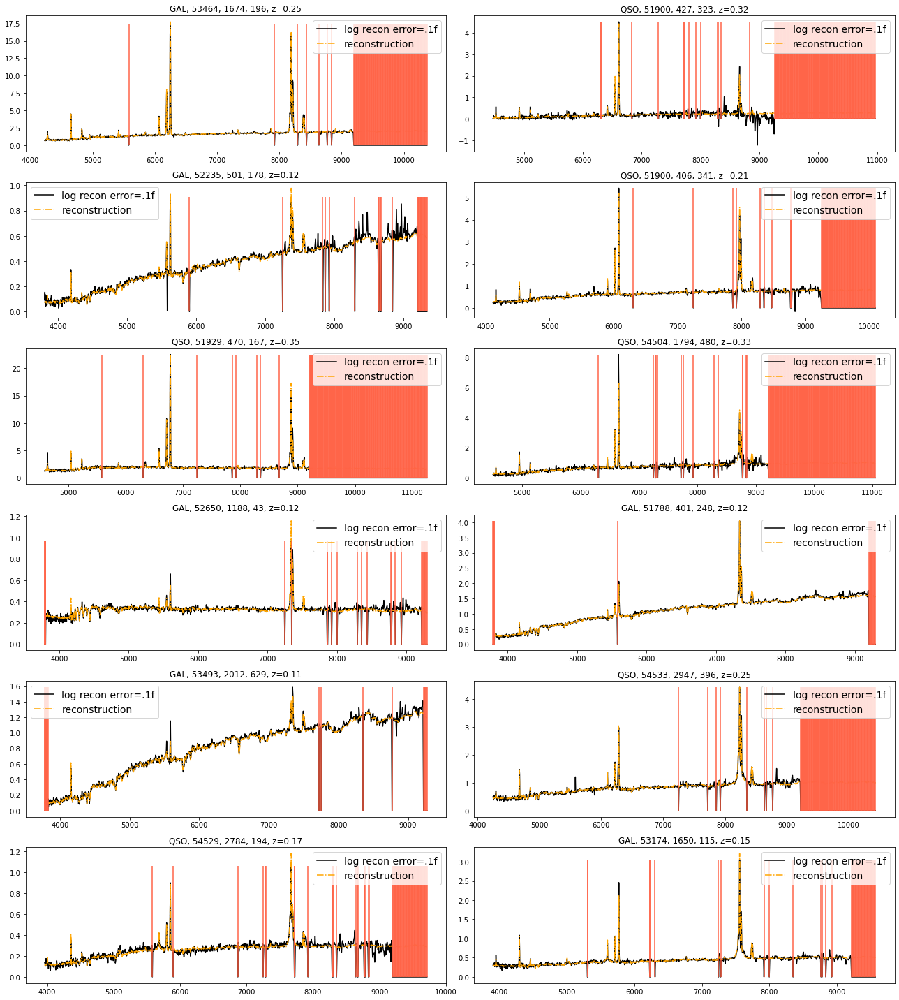

Most Normal Spectra


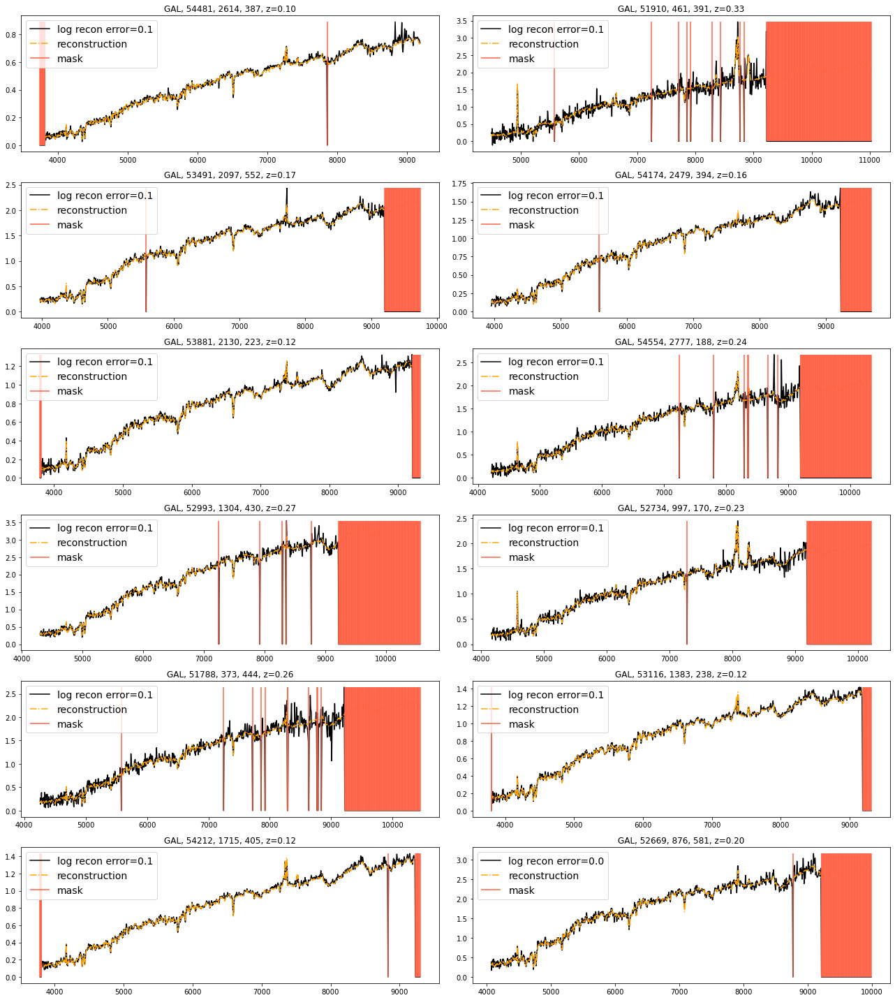

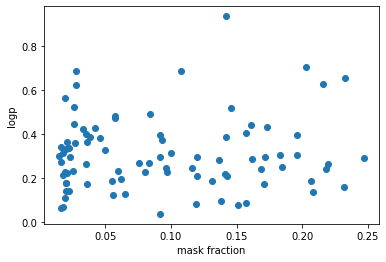

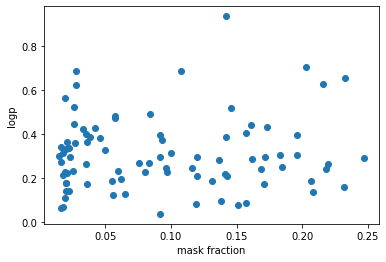

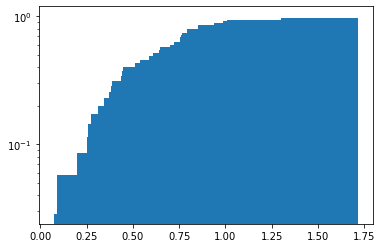

Anomalous Spectra


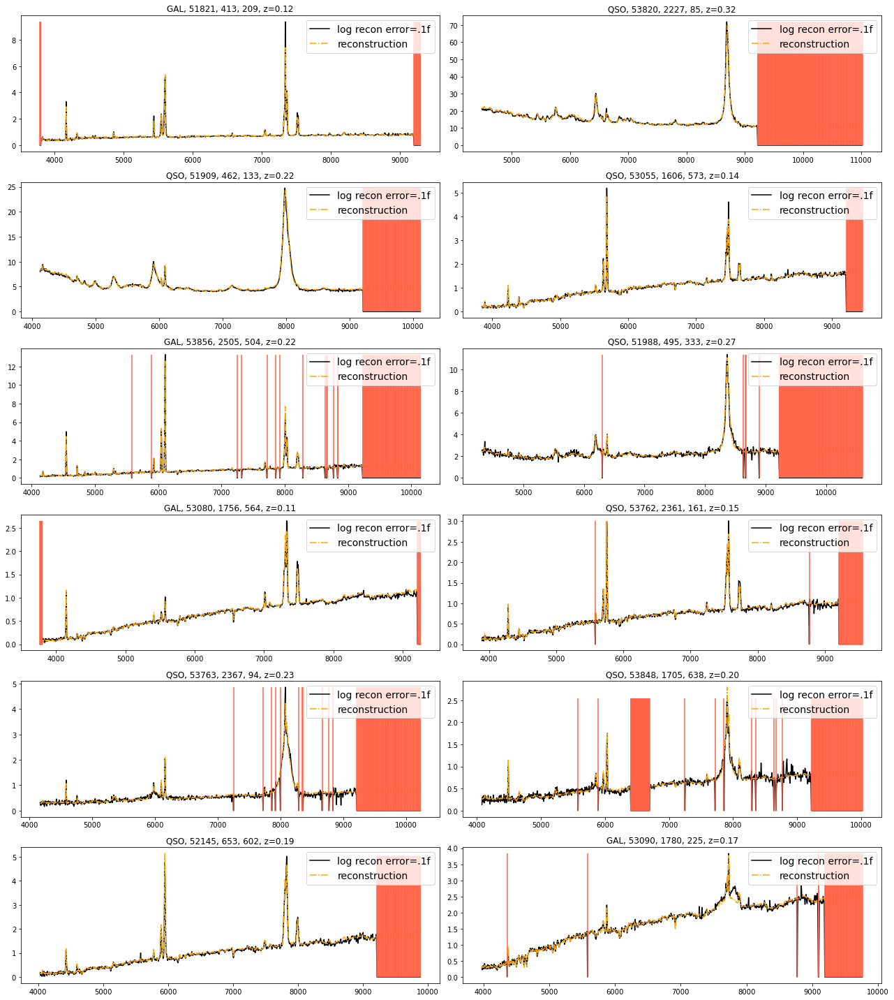

Most Normal Spectra


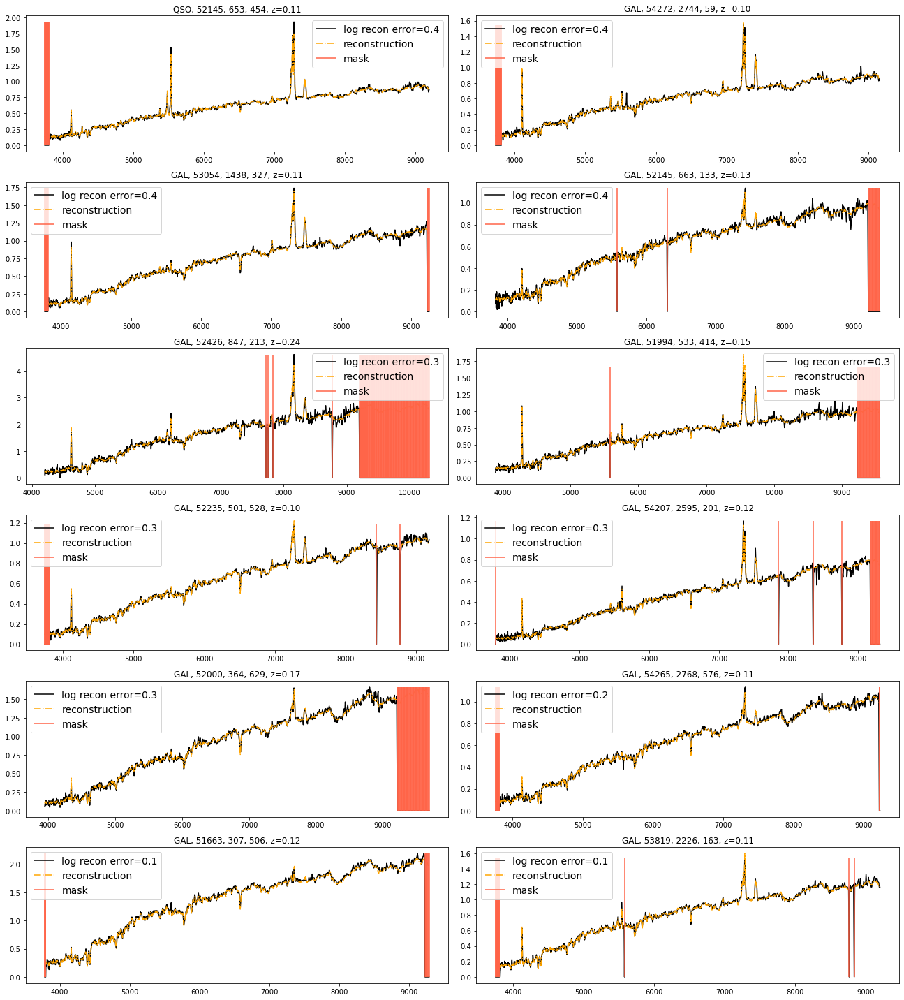

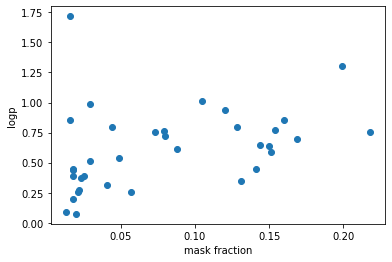

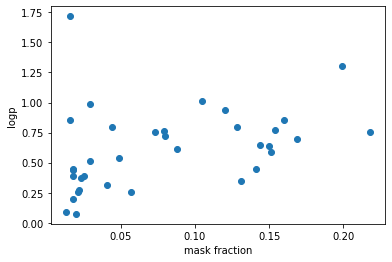

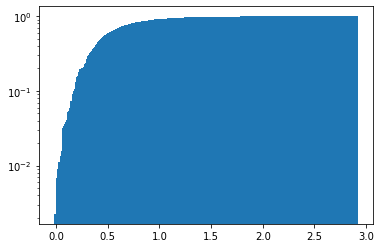

Anomalous Spectra


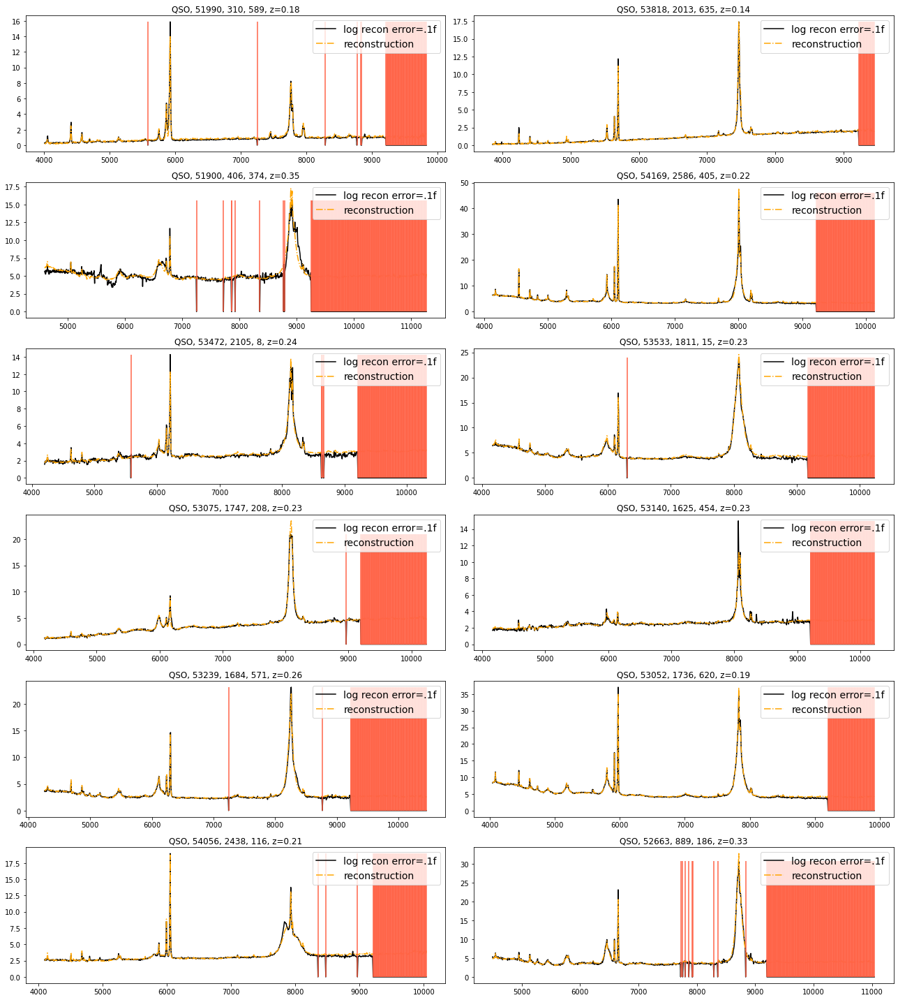

Most Normal Spectra


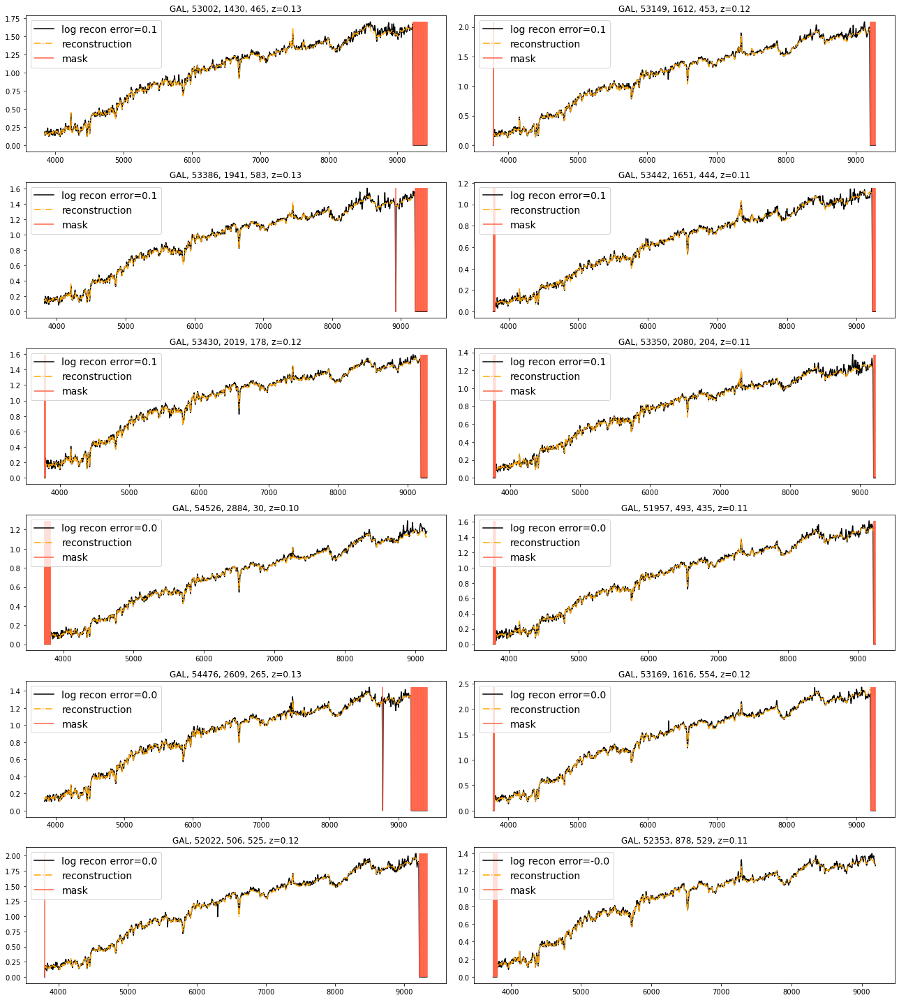

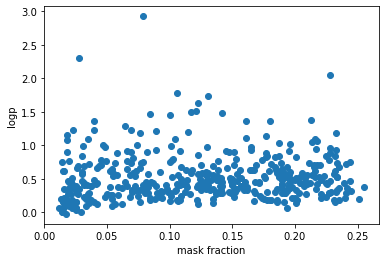

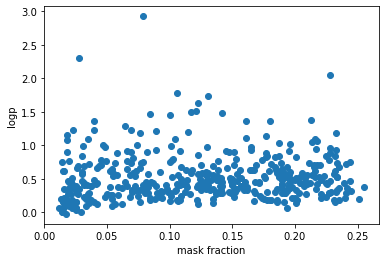

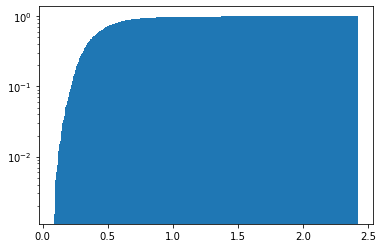

Anomalous Spectra


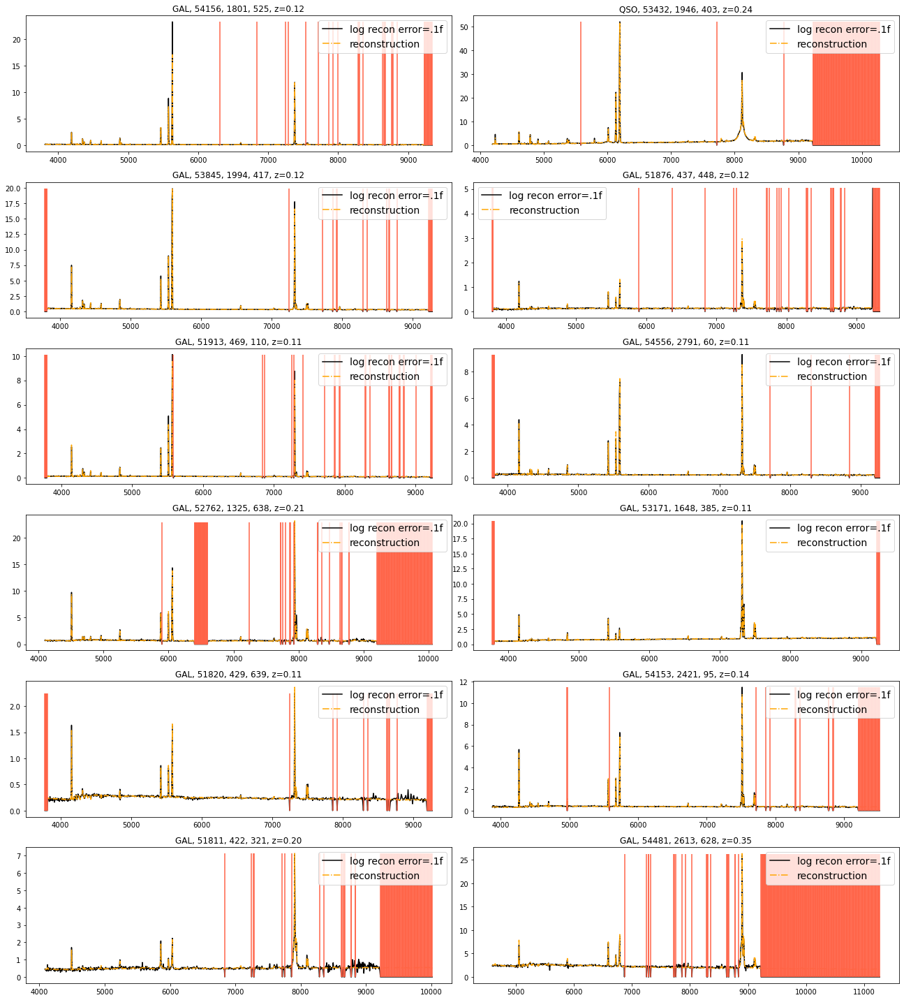

Most Normal Spectra


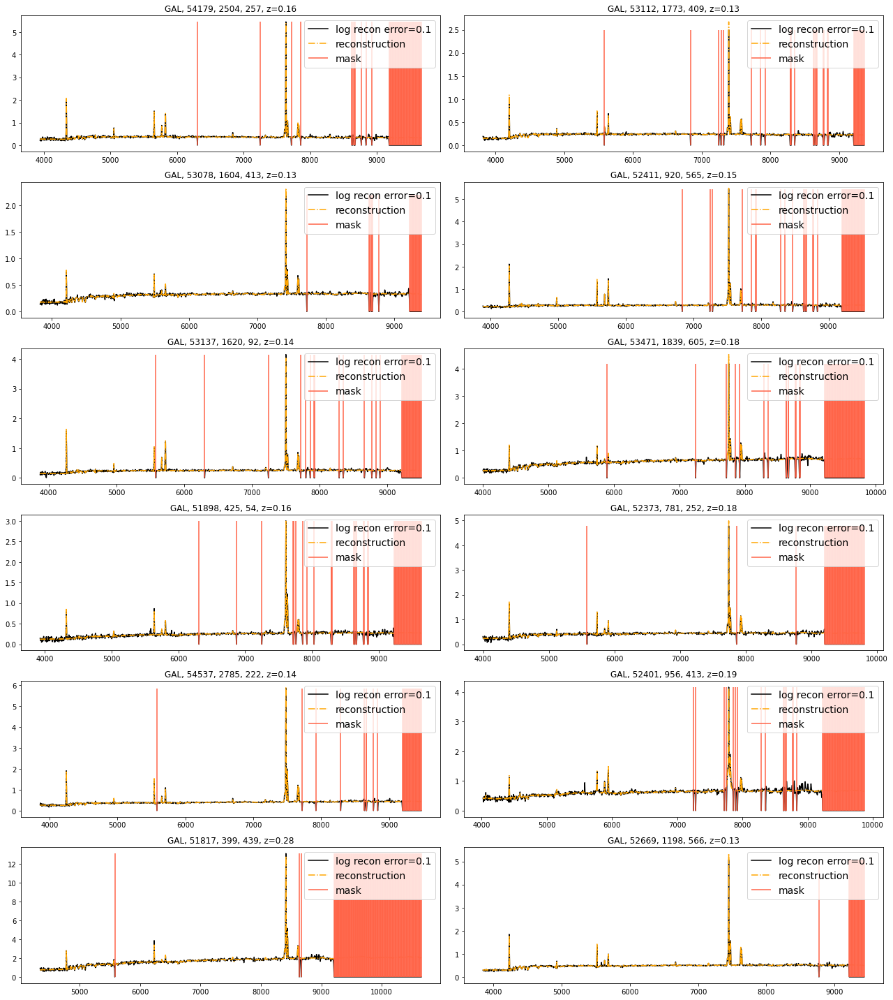

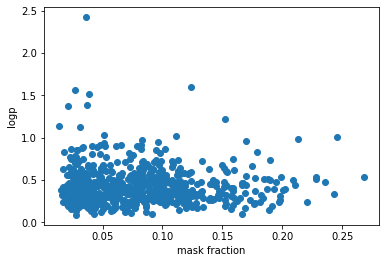

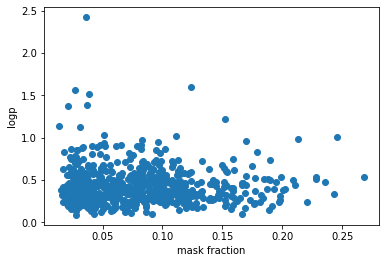

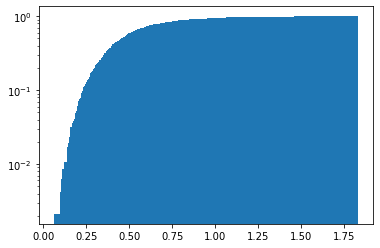

Anomalous Spectra


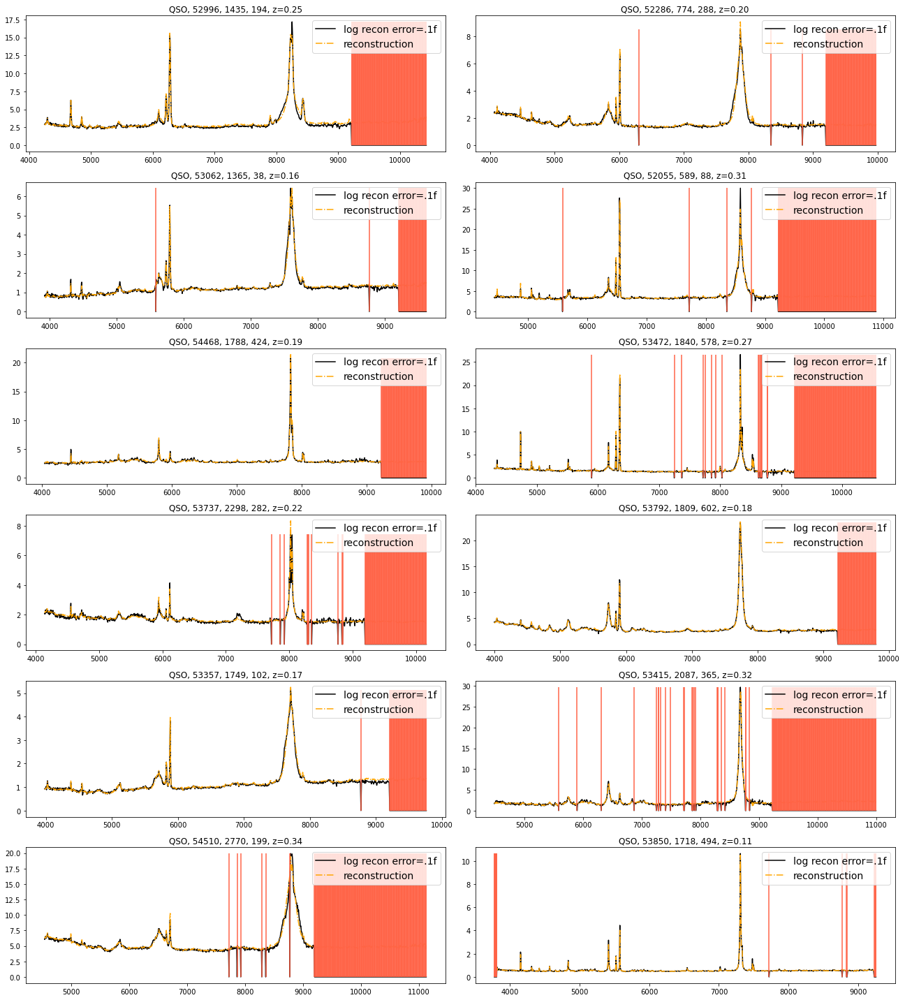

Most Normal Spectra


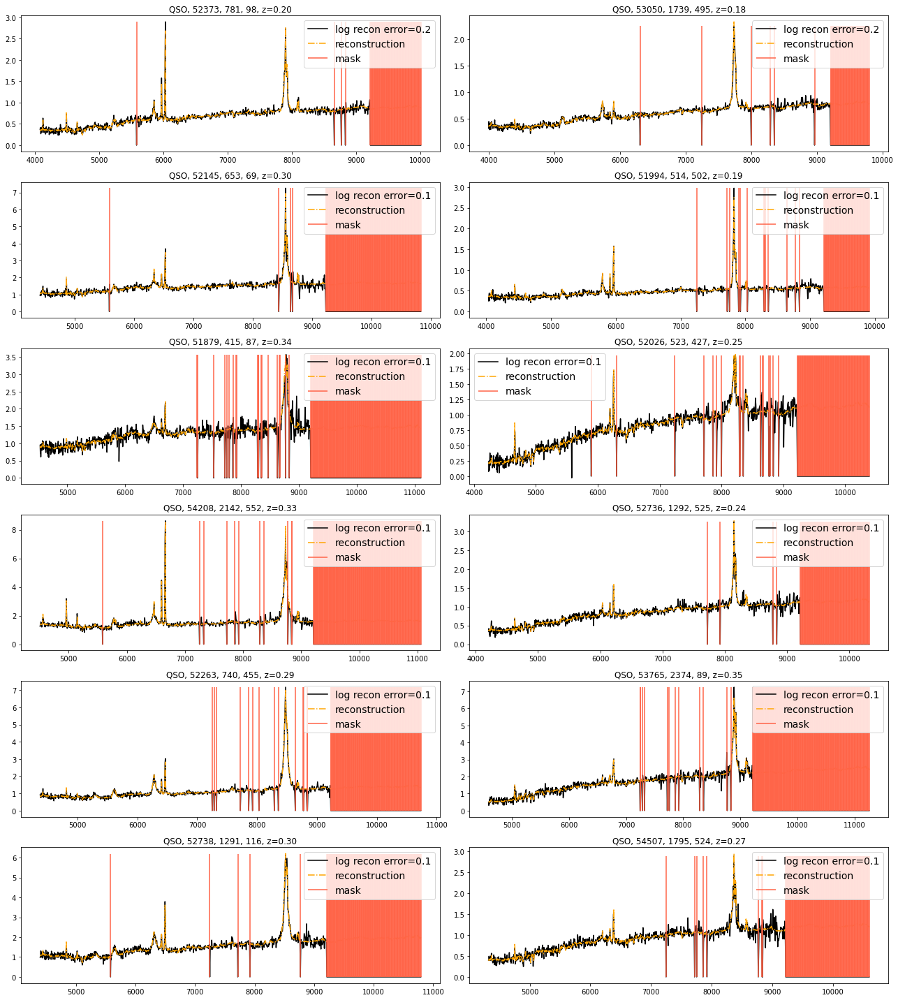

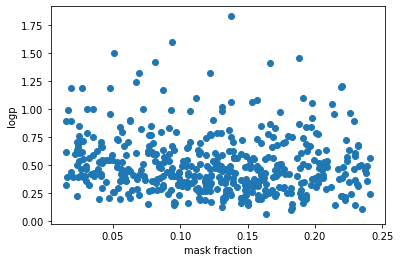

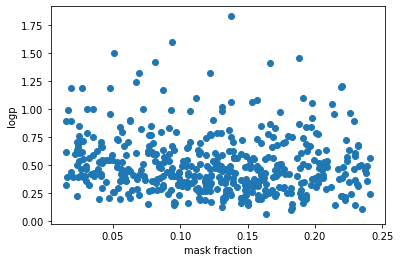

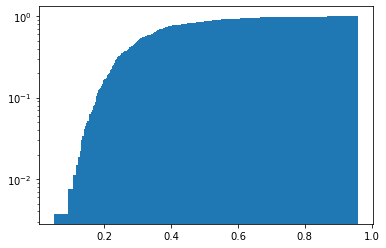

Anomalous Spectra


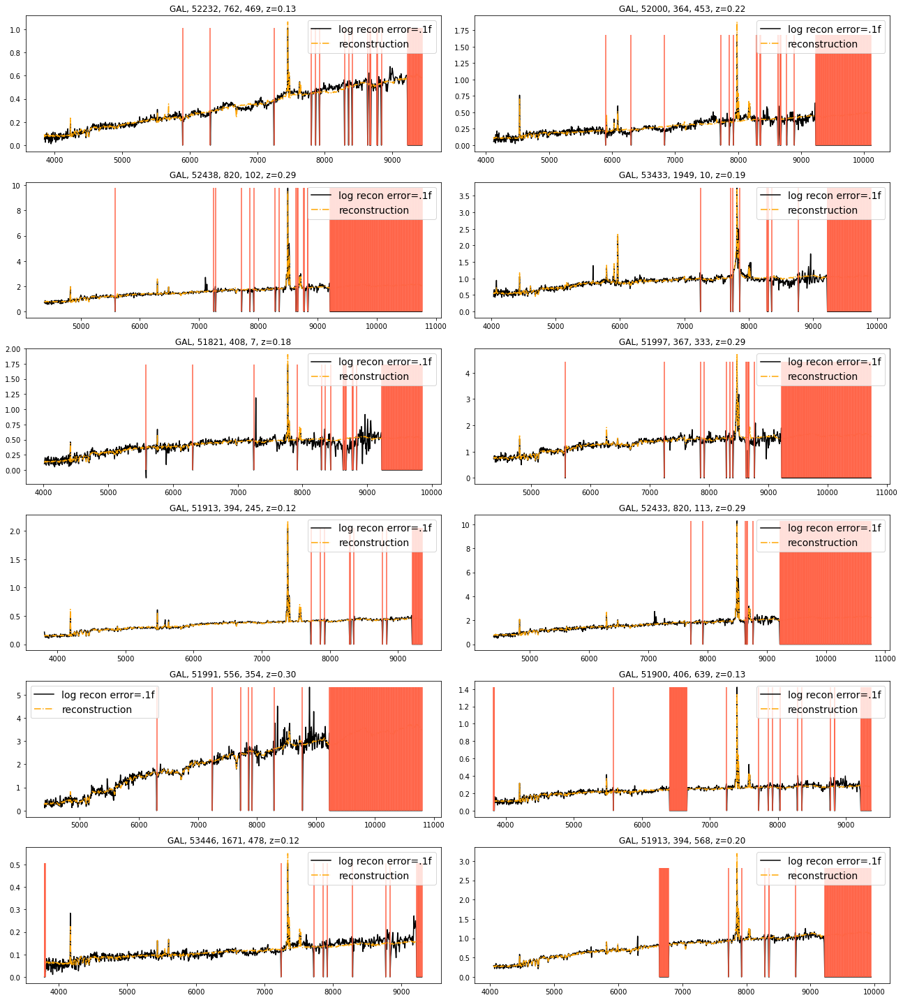

Most Normal Spectra


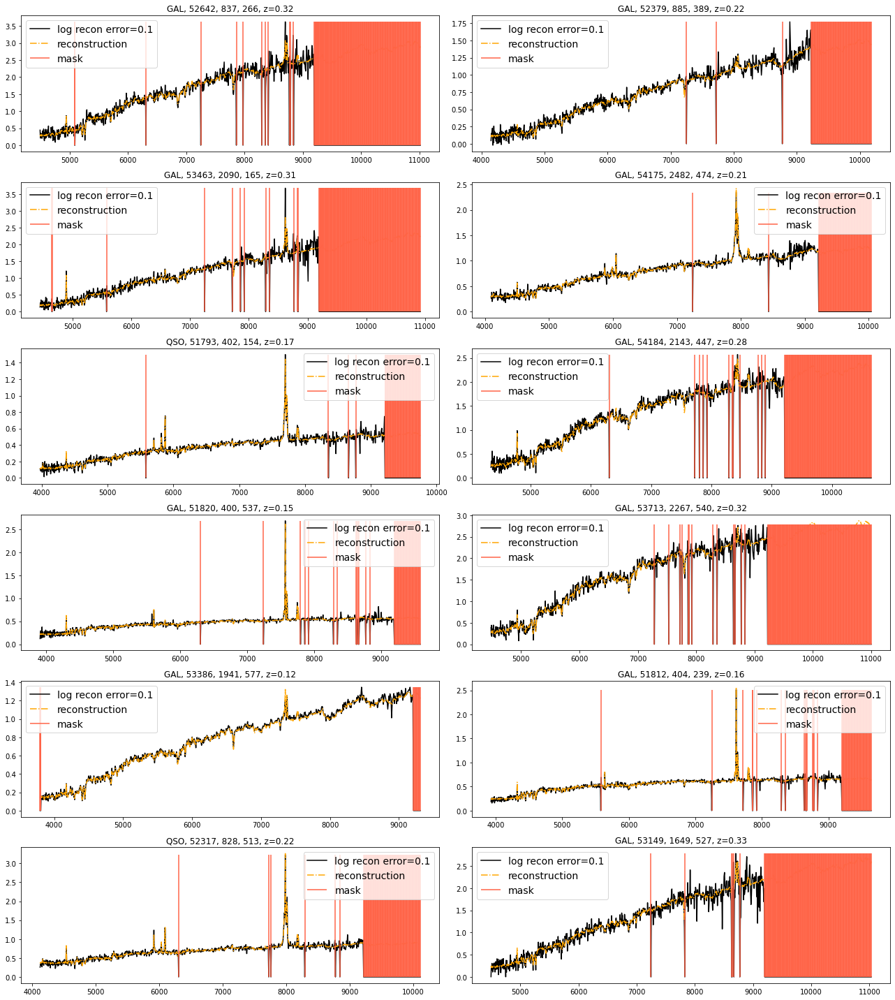

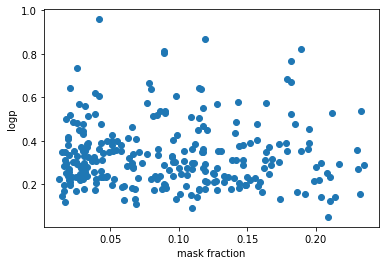

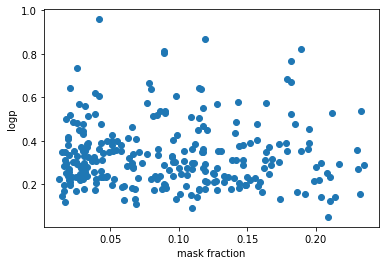

In [121]:
for mm in range(7):
    ind = np.where(test['subclass']==mm)[0]

    mask_fracs      = np.sum(~test['mask'].astype('bool'),axis=1)/1000

    dens            = df['log_error_corr'].iloc[ind].to_numpy()

    ind_ood         = np.argsort(dens)[::-1]
    dens_sorted     = dens[ind_ood]
    test_x_sorted   = test_x[ind].cpu().numpy()[ind_ood]


    cum, bins, _      = plt.hist(dens_sorted,bins=500,density=True, cumulative=True, log=True)
    plt.show()

    outliers_decoded  = decoded_test[ind][ind_ood]
    outliers_input    = test['spec'][ind][ind_ood]

    wlmin, wlmax      = (3388,8318)
    fixed_num_bins    = 1000
    wl_range          = (np.log10(wlmin),np.log10(wlmax))
    # new binning 
    new_wl            = np.logspace(wl_range[0],wl_range[1],fixed_num_bins+1)


    print('Anomalous Spectra')
    fi, ax = plt.subplots(6,2,figsize=(18,20))
    ax = ax.flatten()
    for ii in range(12):
        ax[ii].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
        ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='log recon error=.1f'%dens_sorted[ii], color='black')
        ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
        ax[ii].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4)

        ax[ii].legend(fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(plotpath,'recon_error_outliers_class_%s'%(le.inverse_transform([mm])[0]).decode('utf8')), bbox_inches='tight')
    plt.show()

    print('Most Normal Spectra')
    fi, ax = plt.subplots(6,2,figsize=(18,20))
    ax = ax.flatten()
    for nn, ii in enumerate(range(len(ind_ood)-12,len(ind_ood))):
        ax[nn].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
        ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='log recon error=%.1f'%dens_sorted[ii], color='black')
        ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
        ax[nn].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4, label='mask')

        ax[nn].legend(fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(plotpath,'recon_error_most_common_class_%s'%(le.inverse_transform([mm])[0]).decode('utf8')), bbox_inches='tight')
    plt.show()

    mask_fracs = np.sum(~test['mask'].astype('bool'),axis=1)/1000

    plt.xlabel('mask fraction')
    plt.ylabel('logp')
    plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
    plt.show()



    plt.xlabel('mask fraction')
    plt.ylabel('logp')
    plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
    plt.show()

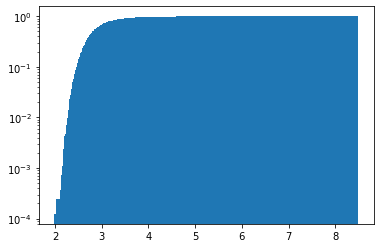

Anomalous Spectra


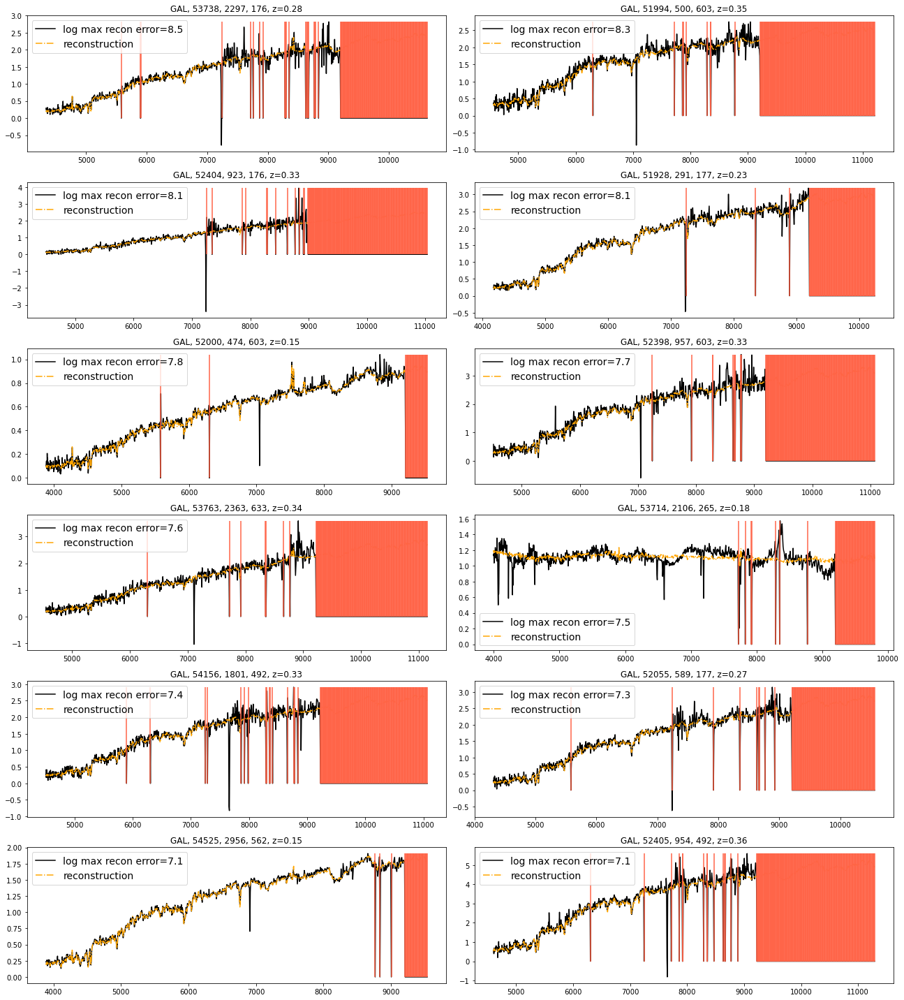

Most Normal Spectra


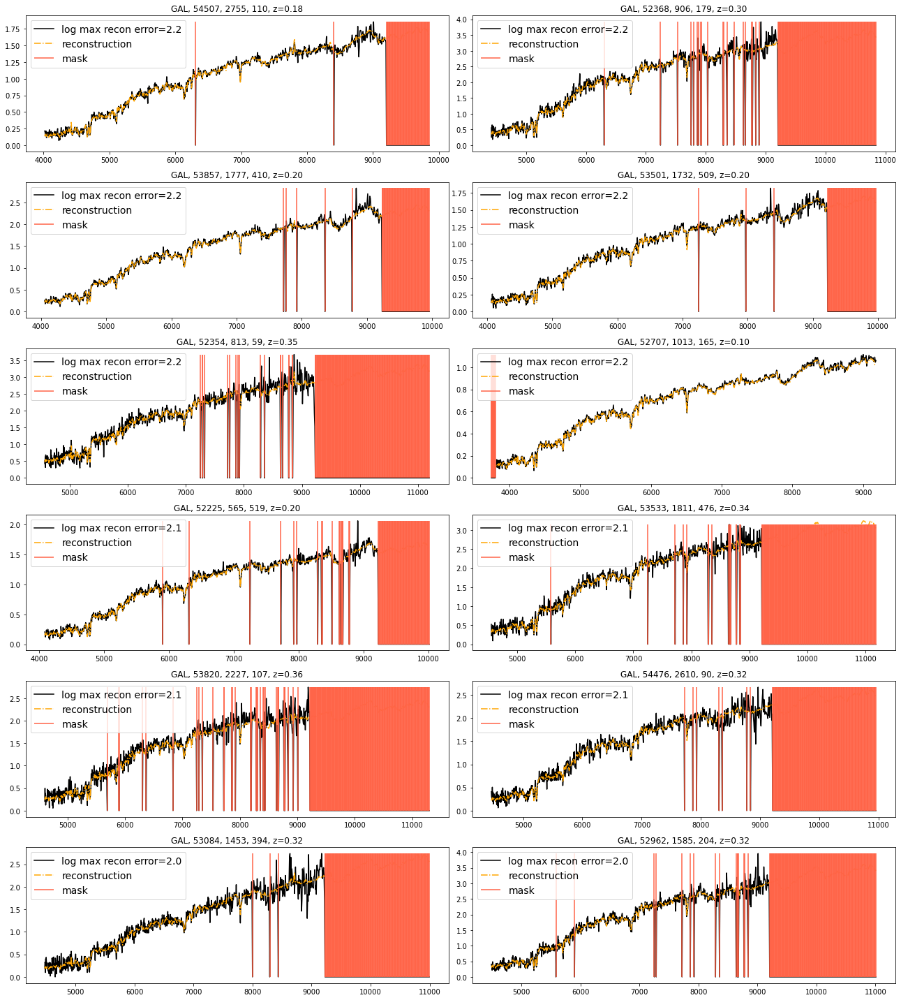

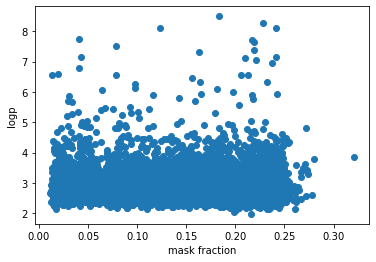

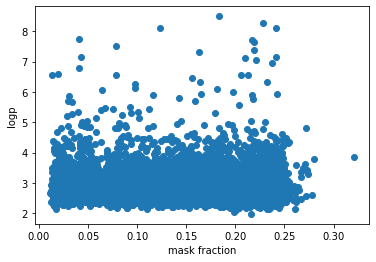

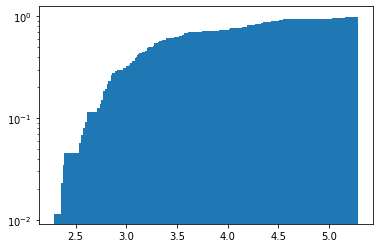

Anomalous Spectra


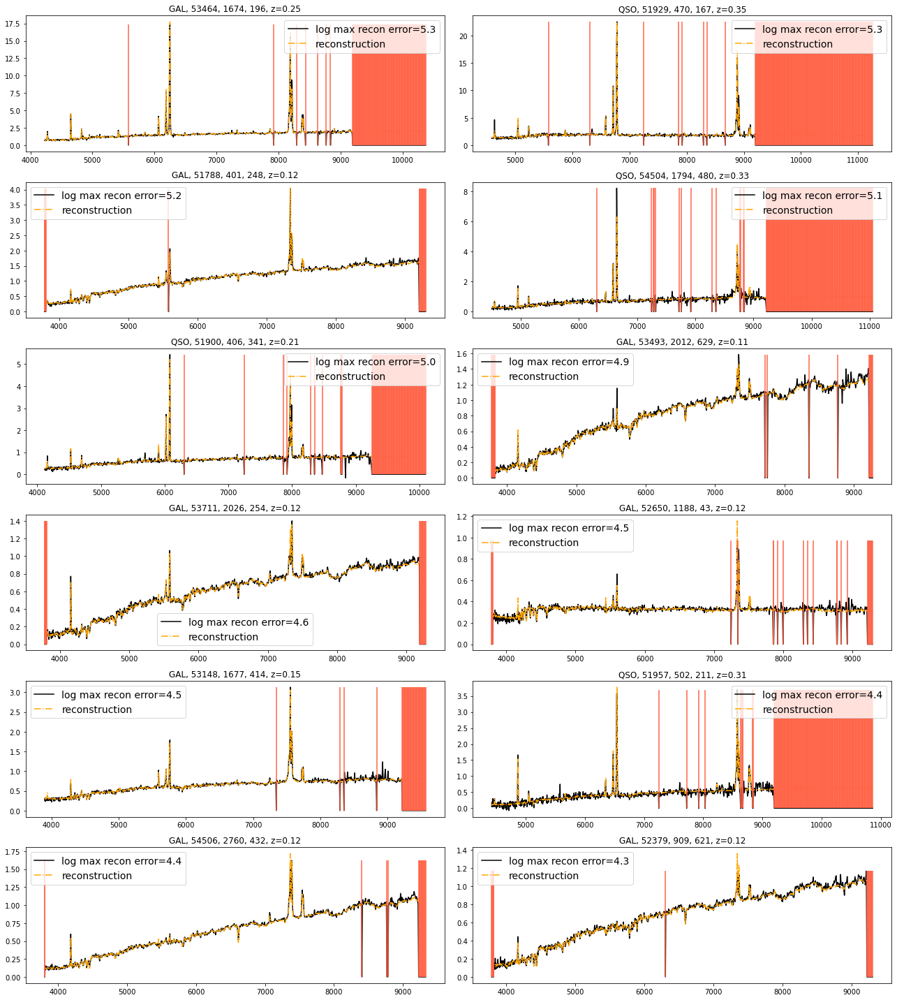

Most Normal Spectra


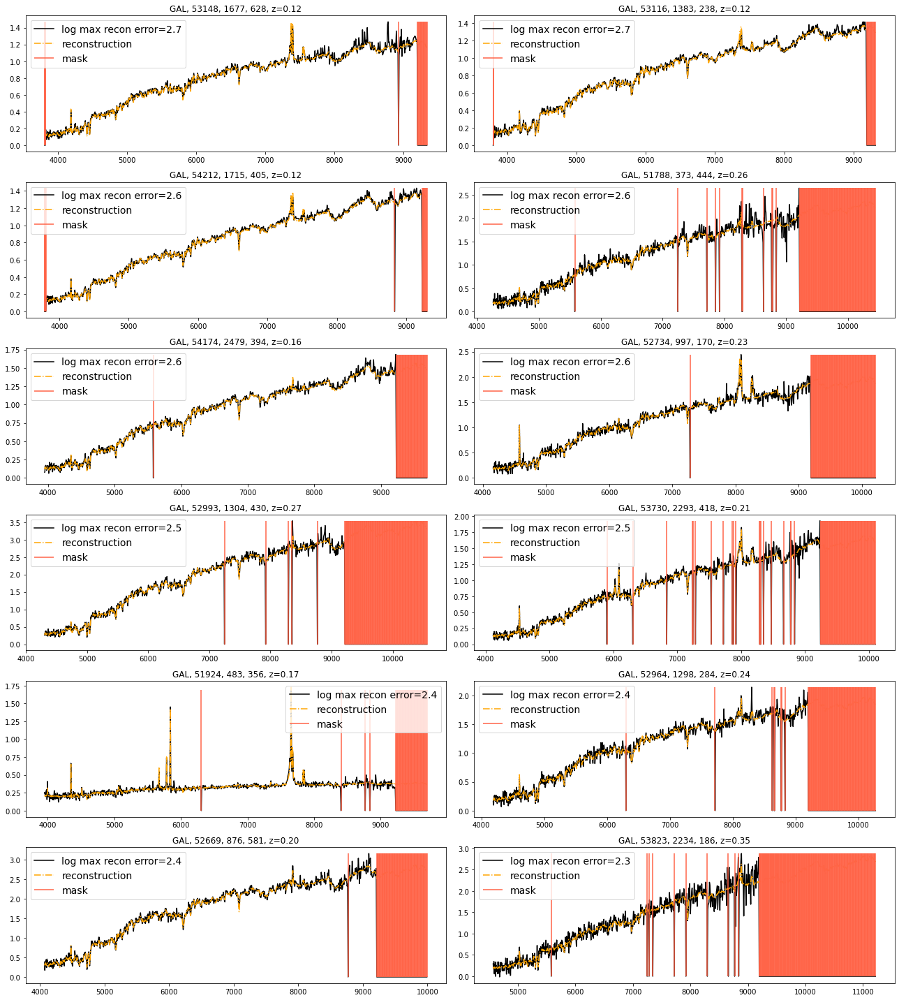

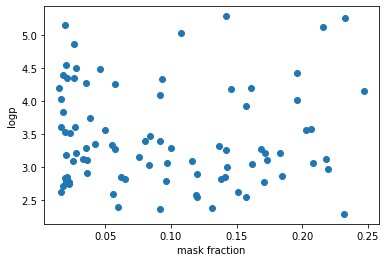

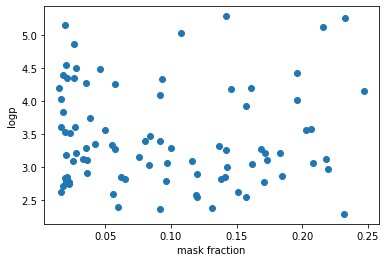

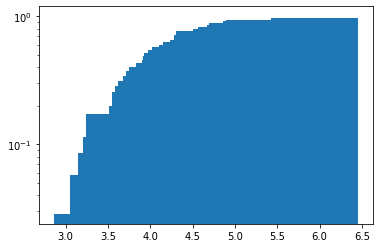

Anomalous Spectra


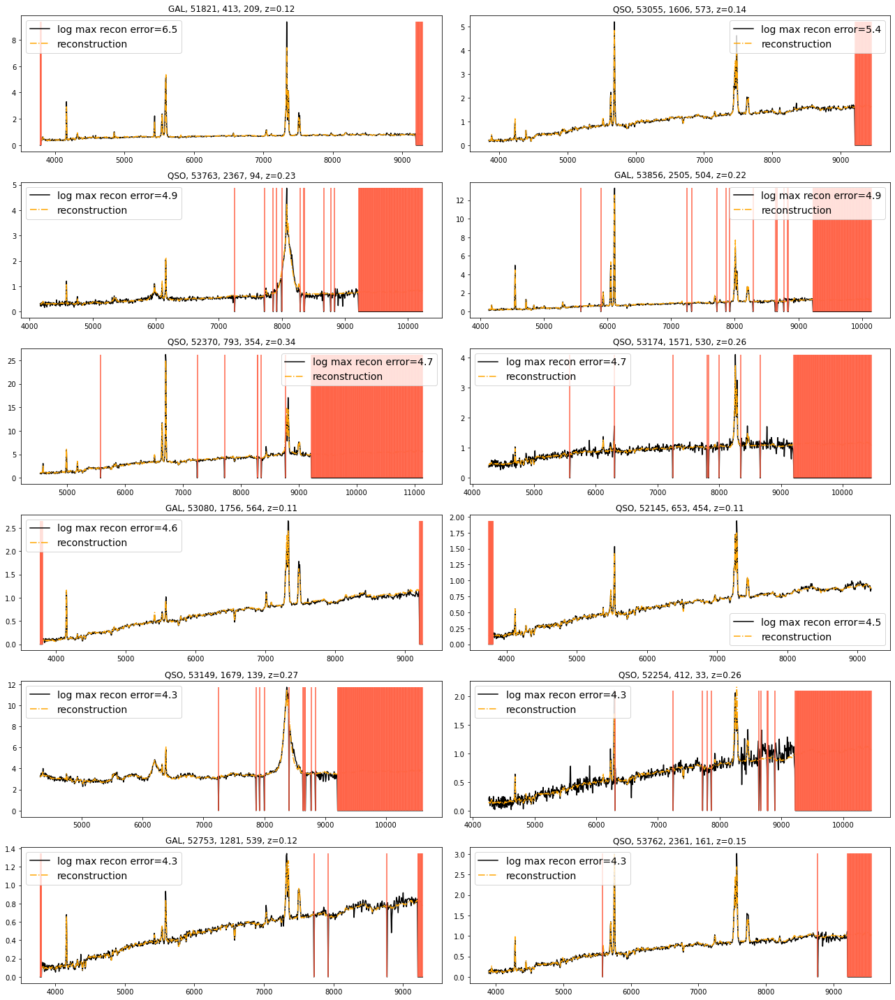

Most Normal Spectra


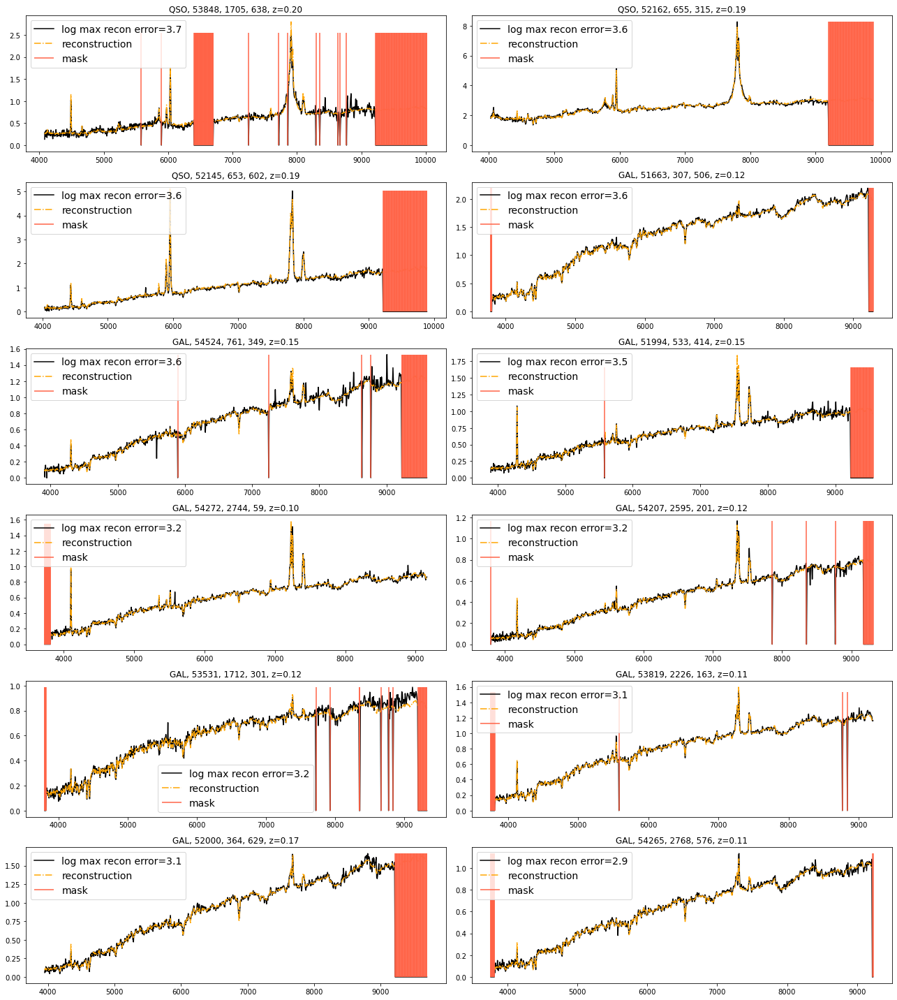

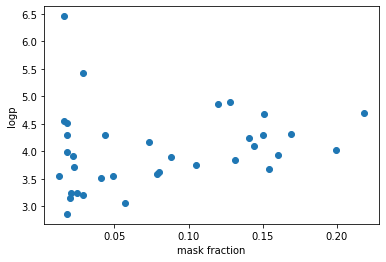

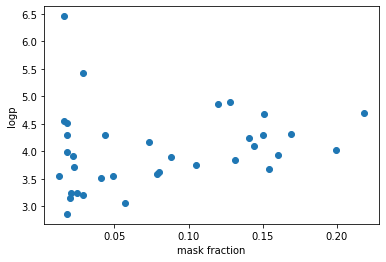

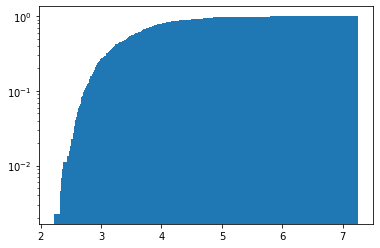

Anomalous Spectra


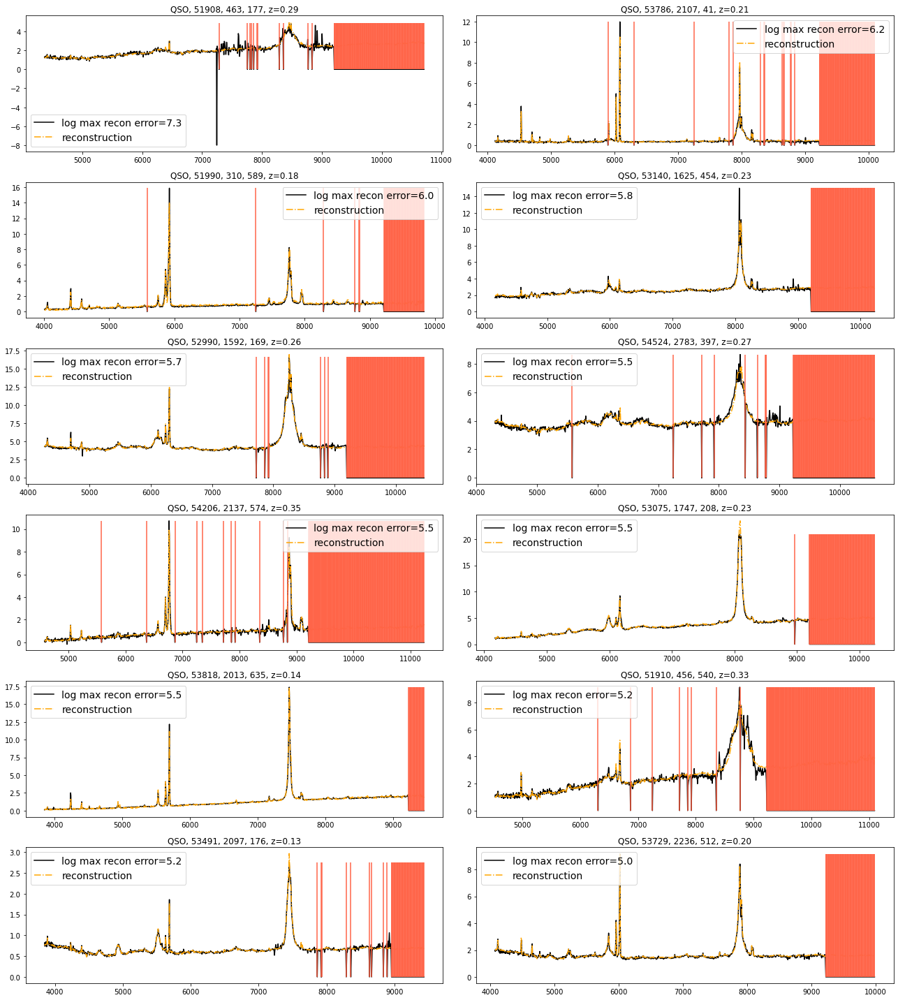

Most Normal Spectra


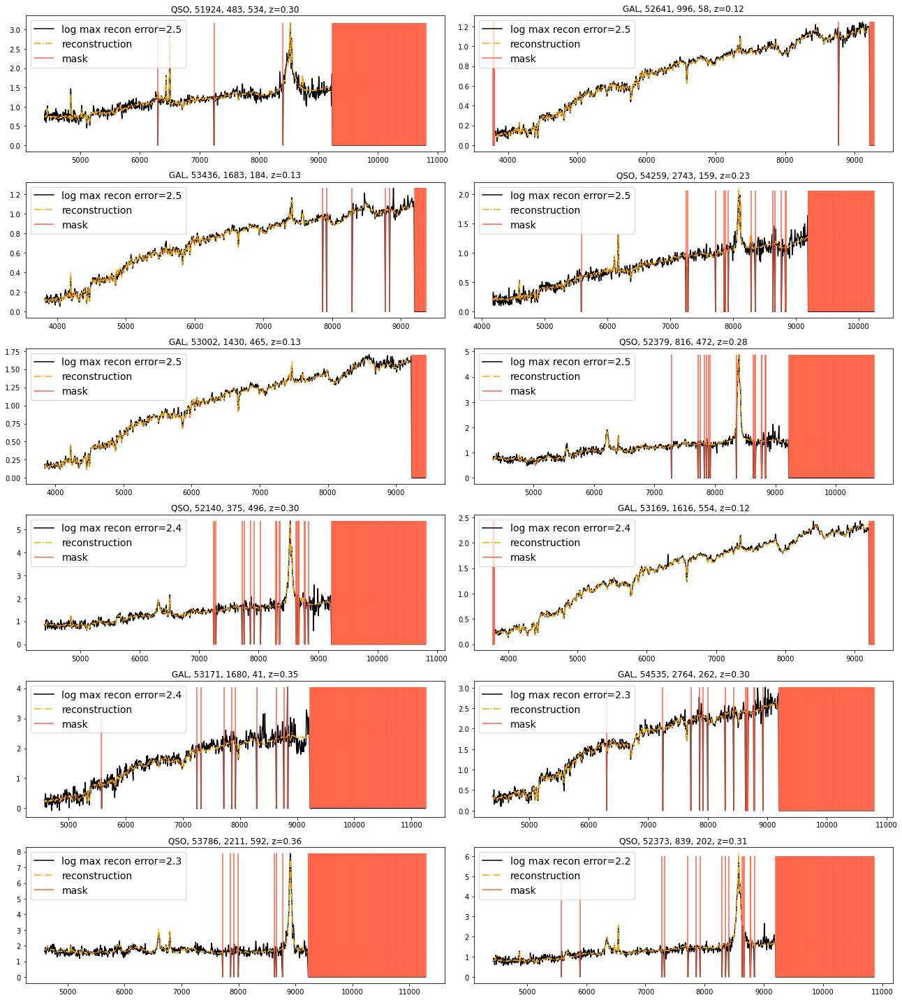

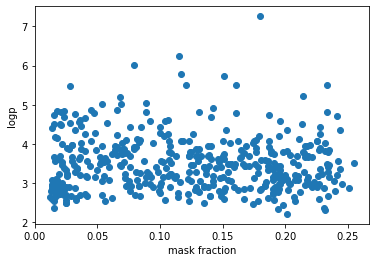

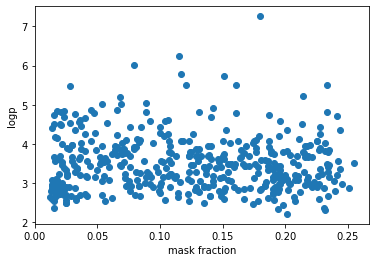

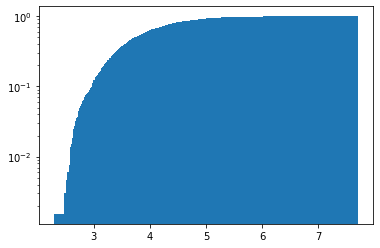

Anomalous Spectra


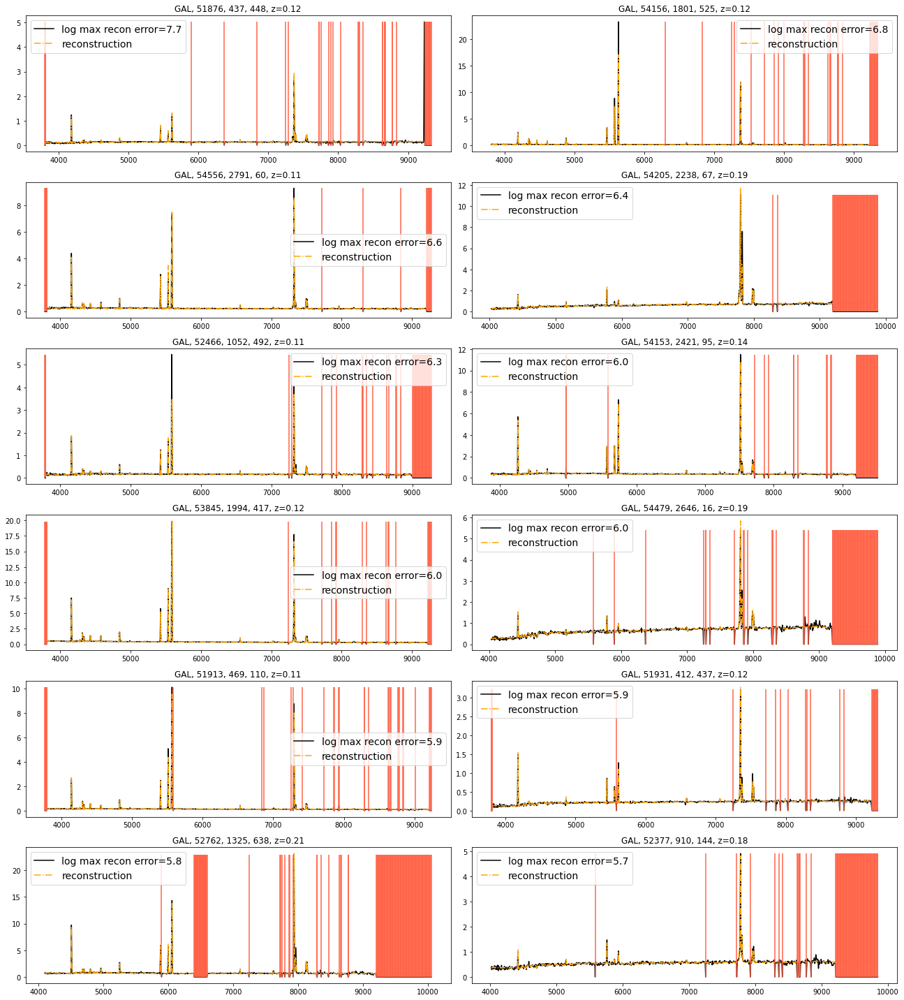

Most Normal Spectra


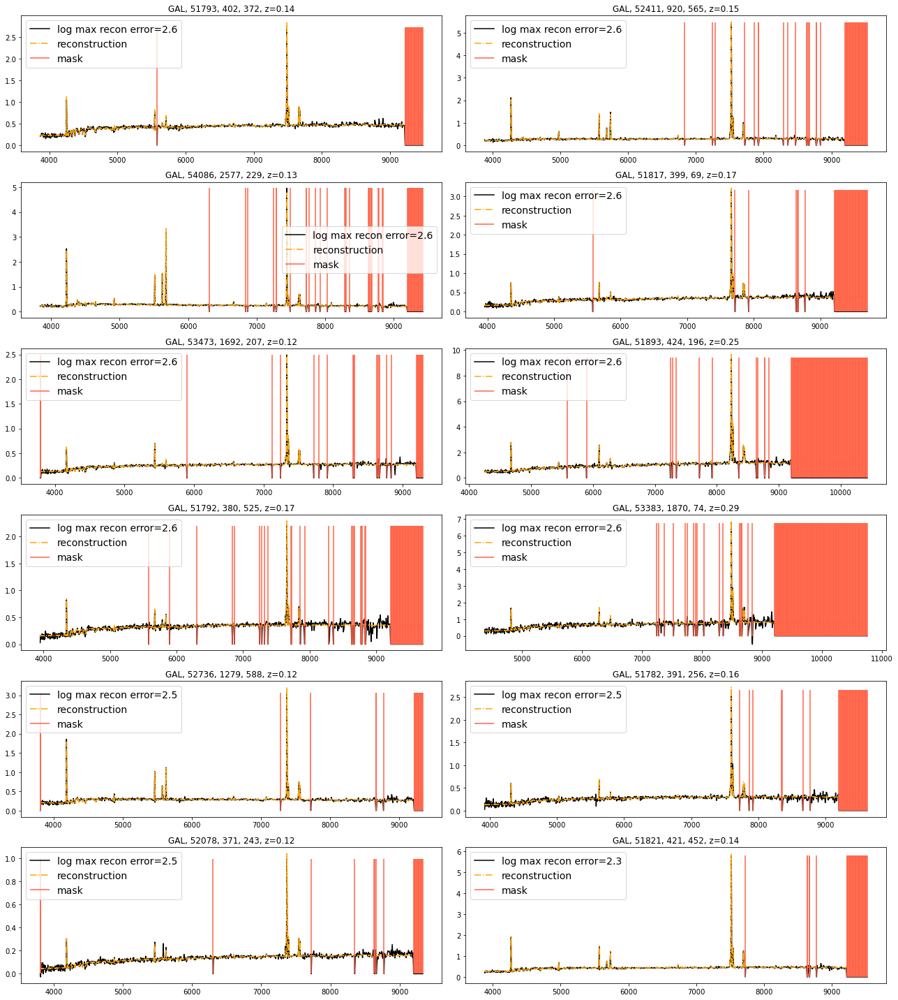

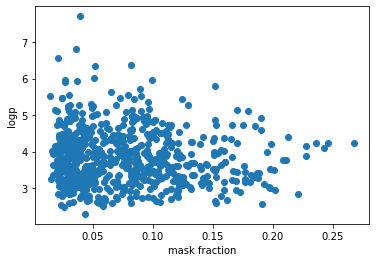

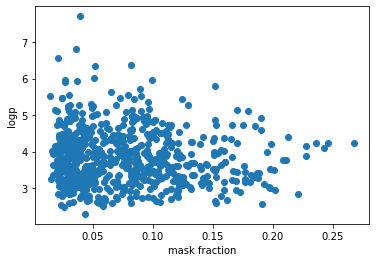

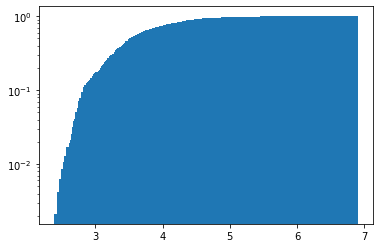

Anomalous Spectra


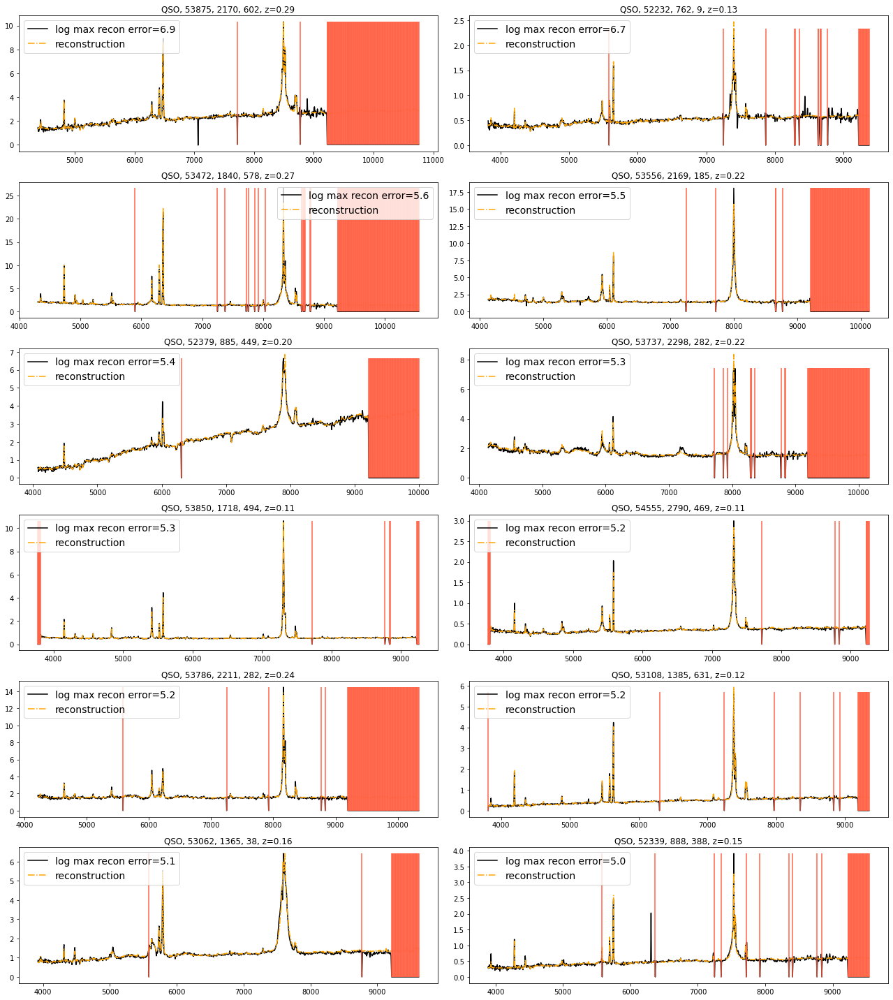

Most Normal Spectra


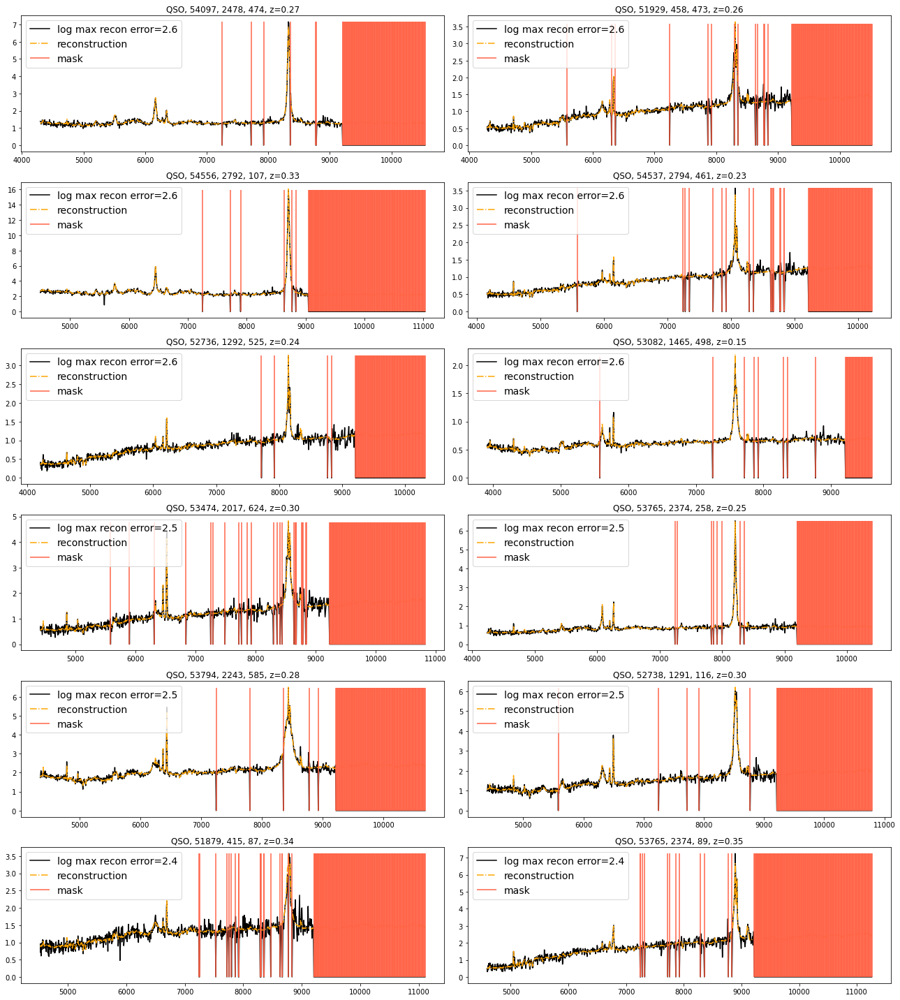

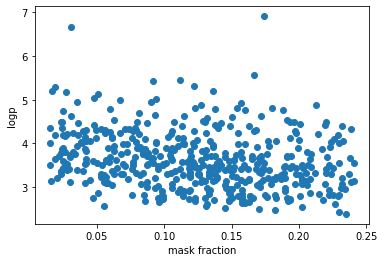

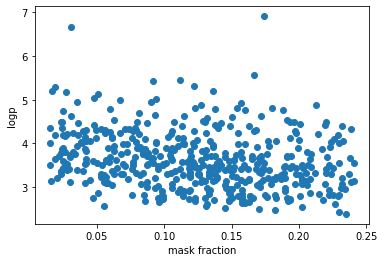

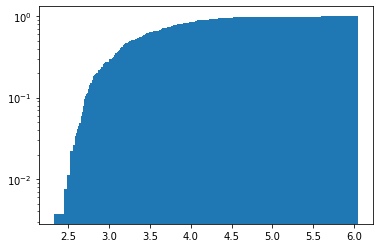

Anomalous Spectra


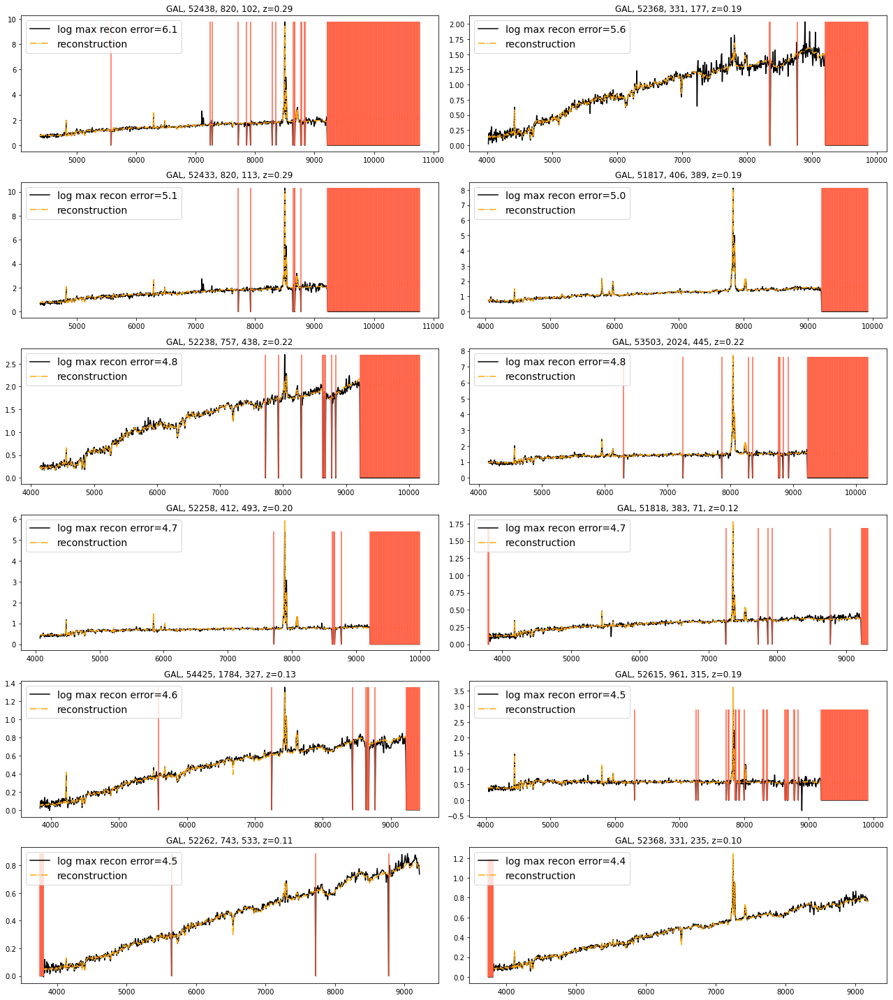

Most Normal Spectra


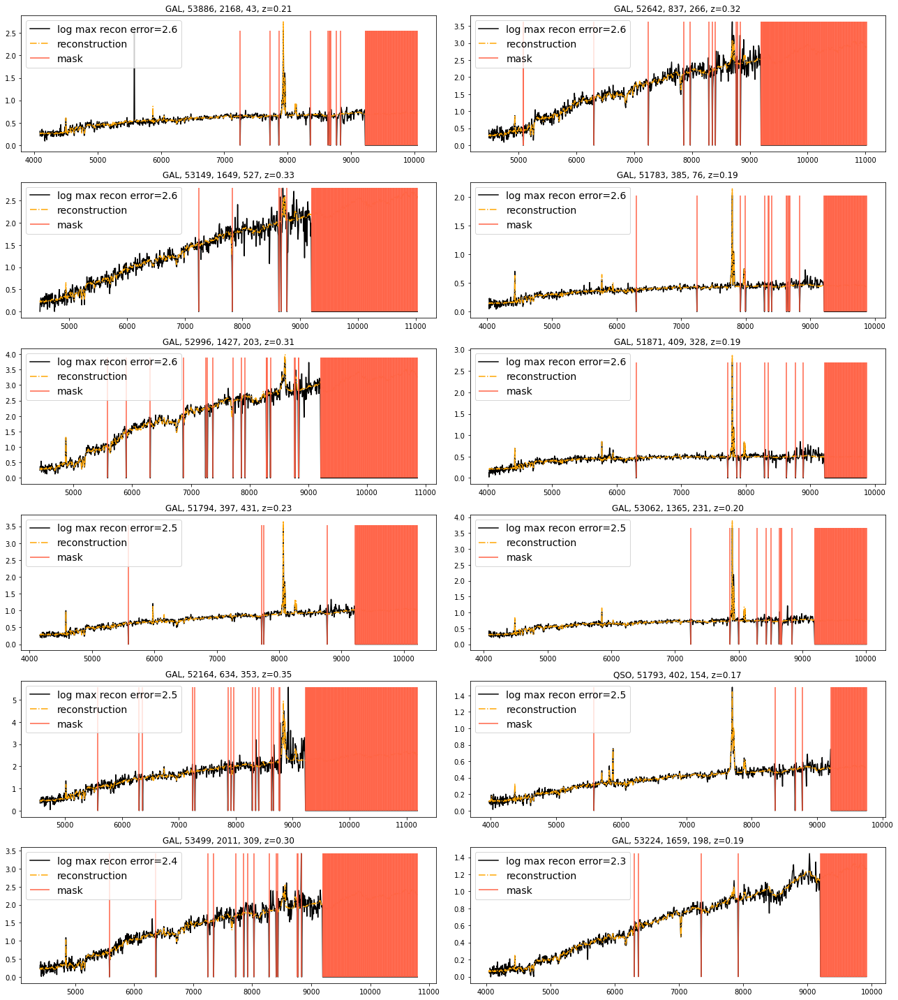

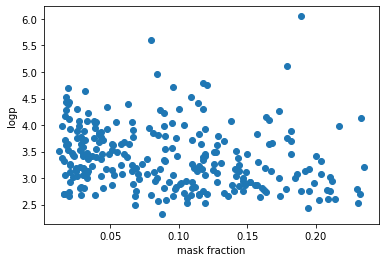

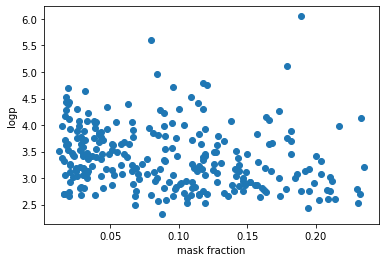

In [122]:
for mm in range(7):
    ind = np.where(test['subclass']==mm)[0]

    mask_fracs      = np.sum(~test['mask'].astype('bool'),axis=1)/1000

    dens            = df['log_max_error_corr'].iloc[ind].to_numpy()

    ind_ood         = np.argsort(dens)[::-1]
    dens_sorted     = dens[ind_ood]
    test_x_sorted   = test_x[ind].cpu().numpy()[ind_ood]


    cum, bins, _      = plt.hist(dens_sorted,bins=500,density=True, cumulative=True, log=True)
    plt.show()

    outliers_decoded  = decoded_test[ind][ind_ood]
    outliers_input    = test['spec'][ind][ind_ood]

    wlmin, wlmax      = (3388,8318)
    fixed_num_bins    = 1000
    wl_range          = (np.log10(wlmin),np.log10(wlmax))
    # new binning 
    new_wl            = np.logspace(wl_range[0],wl_range[1],fixed_num_bins+1)


    print('Anomalous Spectra')
    fi, ax = plt.subplots(6,2,figsize=(18,20))
    ax = ax.flatten()
    for ii in range(12):
        ax[ii].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
        ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='log max recon error=%.1f'%dens_sorted[ii], color='black')
        ax[ii].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
        ax[ii].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4)

        ax[ii].legend(fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(plotpath,'max_recon_error_outliers_class_%s'%(le.inverse_transform([mm])[0]).decode('utf8')), bbox_inches='tight')
    plt.show()

    print('Most Normal Spectra')
    fi, ax = plt.subplots(6,2,figsize=(18,20))
    ax = ax.flatten()
    for nn, ii in enumerate(range(len(ind_ood)-12,len(ind_ood))):
        ax[nn].set_title('%s, %d, %d, %d, z=%.2f'%(classes[test['class'][ind][ind_ood][ii]], test['MJD'][ind][ind_ood][ii],test['plate'][ind][ind_ood][ii],test['fiber'][ind][ind_ood][ii],test['z'][ind][ind_ood][ii]))
        ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_input[ii],label='log max recon error=%.1f'%dens_sorted[ii], color='black')
        ax[nn].plot(new_wl[1:]*(test['z'][ind][ind_ood][ii]+1),outliers_decoded[ii], label='reconstruction',ls='-.', color='orange')
        ax[nn].vlines( x=new_wl[1:][np.squeeze(~test['mask'][ind][ind_ood][ii].astype(bool))]*(1+test['z'][ind][ind_ood][ii]), ymin=0,ymax=max(test['spec'][ind][ind_ood][ii]), color='tomato',alpha=1,zorder=4, label='mask')

        ax[nn].legend(fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(plotpath,'max_recon_error_most_common_class_%s'%(le.inverse_transform([mm])[0]).decode('utf8')), bbox_inches='tight')
    plt.show()

    mask_fracs = np.sum(~test['mask'].astype('bool'),axis=1)/1000

    plt.xlabel('mask fraction')
    plt.ylabel('logp')
    plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
    plt.show()



    plt.xlabel('mask fraction')
    plt.ylabel('logp')
    plt.scatter(mask_fracs[ind][ind_ood],dens_sorted)
    plt.show()

In [ ]:
df.columns, df_extern.columns

In [ ]:
df.rename(columns={'MJD':' mjd', 'fiber':' fiber'}, inplace=True)

In [ ]:
df_overlap = df_extern.merge(df,how='inner',on=['plate',' mjd',' fiber'])

In [ ]:
scipy.stats.pearsonr(df_overlap['logp'],df_overlap[' weirdness']), scipy.stats.pearsonr(df_overlap['logp_corr'],df_overlap[' weirdness'])

In [ ]:
plt.scatter(df_overlap[' weirdness'],-df_overlap['logp'],s=1)
plt.xlabel('weirdness')
plt.ylabel('-logp')

In [ ]:
df_overlap_cut = df_overlap[df_overlap['logp']>-50]

In [ ]:
plt.scatter(df_overlap_cut[' weirdness'],-df_overlap_cut['logp'],s=1,c=df_overlap_cut['mask_fracs'])
plt.colorbar()
plt.xlabel('weirdness')
plt.ylabel('-logp')

In [ ]:
plt.scatter(df_overlap_cut[' weirdness'],-df_overlap_cut['logp_corr'],s=1,c=df_overlap_cut['mask_fracs'])
plt.colorbar()
plt.xlabel('weirdness')
plt.ylabel('-logp')

In [ ]:
plt.scatter(df_overlap_cut[' weirdness'],-df_overlap_cut['logp_corr'],s=1,c=df_overlap_cut['z'])
plt.colorbar()
plt.xlabel('weirdness')
plt.ylabel('-logp')

In [ ]:
plt.scatter(df_overlap_cut[' weirdness'],np.log(df_overlap_cut['recon_error']),s=1,c=df_overlap_cut['z'])
plt.colorbar()
plt.xlabel('weirdness')
plt.ylabel('recon error')

In [ ]:
df_overlap_cut = df_overlap_cut[df_overlap_cut['subclass']==0]
plt.scatter(df_overlap_cut[' weirdness'],-df_overlap_cut['logp_corr'],s=1,c=df_overlap_cut['mask_fracs'])
plt.xlabel('weirdness')
plt.ylabel('-logp')

In [ ]:
df_overlap_cut = df_overlap_cut[df_overlap_cut['mask_fracs']<0.1]
plt.scatter(df_overlap_cut[' weirdness'],-df_overlap_cut['logp_corr'],s=1)
plt.colorbar()
plt.xlabel('weirdness')
plt.ylabel('-logp')

In [ ]:
high_weird_high_logp = df_overlap[(df_overlap[' weirdness']>0.69)*(df_overlap['logp_corr']>-2)]

In [ ]:
high_weird_high_logp['logp'], dens[high_weird_high_logp['index']]

In [ ]:
high_weird_high_logp[' mjd'], test['MJD'][high_weird_high_logp['index']], high_weird_high_logp['index']

### High weirdness, high probability

In [ ]:
ind   = high_weird_high_logp['index']
weird = high_weird_high_logp[' weirdness']
logp  = high_weird_high_logp.logp

fi, ax = plt.subplots(3,4,figsize=(18,8))
ax = ax.flatten()
for ii in range(len(high_weird_high_logp)):
    nn = ind.iloc[ii]
    ax[ii].set_title('%s, %s, %d, %d, %d, z=%.2f'%(classes[test['class'][nn]], le.inverse_transform([test['subclass'][nn]]), test['MJD'][nn],test['plate'][nn],test['fiber'][nn],test['z'][nn]))
    ax[ii].plot(new_wl[1:]*(1+test['z'][nn]),test['spec'][nn],label='logp=%.1f, weirdness=%.2f'%(logp.iloc[ii],weird.iloc[ii]))
    ax[ii].plot(new_wl[1:]*(1+test['z'][nn]),decoded_test[nn], label='reconstruction',ls=':')
    ax[ii].vlines( x=new_wl[1:][np.squeeze(~test['mask'][nn].astype(bool))]*(1+test['z'][nn]), ymin=0,ymax=1, color='red',zorder=3)
    ax[ii].set_ylim(0,1)
    ax[ii].legend()
plt.tight_layout()
plt.show()

In [ ]:
(new_wl[1:][np.squeeze(~test['mask'][nn].astype(bool))]*(1+test['z'][nn])).shape

In [ ]:
low_weird_low_logp = df_overlap[(df_overlap[' weirdness']<0.45)*(df_overlap['logp_corr']<-20)]

In [ ]:
low_weird_low_logp

In [ ]:
ind   = low_weird_low_logp['index']
weird = low_weird_low_logp[' weirdness']
logp  = low_weird_low_logp.logp

fi, ax = plt.subplots(3,4,figsize=(18,8))
ax = ax.flatten()
for ii in range(min(len(low_weird_low_logp),12)):
    nn = ind.iloc[ii]
    ax[ii].set_title('%s, %s, %d, %d, %d, z=%.2f'%(classes[test['class'][nn]], le.inverse_transform([test['subclass'][nn]]), test['MJD'][nn],test['plate'][nn],test['fiber'][nn],test['z'][nn]))
    ax[ii].plot(new_wl[1:]*(1+test['z'][nn]),test['spec'][nn],label='logp=%.1f, weirdness=%.2f'%(logp.iloc[ii],weird.iloc[ii]))
    ax[ii].plot(new_wl[1:]*(1+test['z'][nn]),decoded_test[nn], label='reconstruction',ls=':')
    ax[ii].vlines( x=new_wl[1:][np.squeeze(~test['mask'][nn].astype(bool))]*(1+test['z'][nn]), ymin=0,ymax=max(test['spec'][nn]), color='red',alpha=0.5,zorder=4)

    ax[ii].legend()
plt.tight_layout()
plt.show()